### Temperature Prediction

This data is for the purpose of bias correction of next-day maximum and minimum air temperatures forecast of the LDAPS model operated by the Korea Meteorological Administration over Seoul, South Korea. This data consists of summer data from 2013 to 2017. The input data is largely composed of the LDAPS model's next-day forecast data, in-situ maximum and minimum temperatures of present-day, and geographic auxiliary variables. There are two outputs (i.e. next-day maximum and minimum air temperatures) in this data. Hindcast validation was conducted for the period from 2015 to 2017.

In [1]:
#import necessary libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [2]:
#read the dataset
df = pd.read_csv('https://raw.githubusercontent.com/dsrscientist/Dataset2/main/temperature.csv')
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


In [5]:
df.shape

(7752, 25)

In [6]:
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

we see there are 25 columns in which 23 are features and 2 are target variables. Since our target variables are continous data we consider this as regression problem.

The description of the columns are:
1. station - used weather station number: 1 to 25
2. Date - Present day: yyyy-mm-dd ('2013-06-30' to '2017-08-30')
3. Present_Tmax - Maximum air temperature between 0 and 21 h on the present day (Â°C): 20 to 37.6
4. Present_Tmin - Minimum air temperature between 0 and 21 h on the present day (Â°C): 11.3 to 29.9
5. LDAPS_RHmin - LDAPS model forecast of next-day minimum relative humidity (%): 19.8 to 98.5
6. LDAPS_RHmax - LDAPS model forecast of next-day maximum relative humidity (%): 58.9 to 100
7. LDAPS_Tmax_lapse - LDAPS model forecast of next-day maximum air temperature applied lapse rate (Â°C): 17.6 to 38.5
8. LDAPS_Tmin_lapse - LDAPS model forecast of next-day minimum air temperature applied lapse rate (Â°C): 14.3 to 29.6
9. LDAPS_WS - LDAPS model forecast of next-day average wind speed (m/s): 2.9 to 21.9
10. LDAPS_LH - LDAPS model forecast of next-day average latent heat flux (W/m2): -13.6 to 213.4
11. LDAPS_CC1 - LDAPS model forecast of next-day 1st 6-hour split average cloud cover (0-5 h) (%): 0 to 0.97
12. LDAPS_CC2 - LDAPS model forecast of next-day 2nd 6-hour split average cloud cover (6-11 h) (%): 0 to 0.97
13. LDAPS_CC3 - LDAPS model forecast of next-day 3rd 6-hour split average cloud cover (12-17 h) (%): 0 to 0.98
14. LDAPS_CC4 - LDAPS model forecast of next-day 4th 6-hour split average cloud cover (18-23 h) (%): 0 to 0.97
15. LDAPS_PPT1 - LDAPS model forecast of next-day 1st 6-hour split average precipitation (0-5 h) (%): 0 to 23.7
16. LDAPS_PPT2 - LDAPS model forecast of next-day 2nd 6-hour split average precipitation (6-11 h) (%): 0 to 21.6
17. LDAPS_PPT3 - LDAPS model forecast of next-day 3rd 6-hour split average precipitation (12-17 h) (%): 0 to 15.8
18. LDAPS_PPT4 - LDAPS model forecast of next-day 4th 6-hour split average precipitation (18-23 h) (%): 0 to 16.7
19. lat - Latitude (Â°): 37.456 to 37.645
20. lon - Longitude (Â°): 126.826 to 127.135
21. DEM - Elevation (m): 12.4 to 212.3
22. Slope - Slope (Â°): 0.1 to 5.2
23. Solar radiation - Daily incoming solar radiation (wh/m2): 4329.5 to 5992.9
    
Our target variables are: 

24. Next_Tmax - The next-day maximum air temperature (Â°C): 17.4 to 38.9

25. Next_Tmin - The next-day minimum air temperature (Â°C): 11.3 to 29.8T



In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


we see there are 25 columns in which 24 are of float type and 1 column is of object type since its a date we need to convert it to numbers. We also see that there is so many null values in all the columns including target columns. so we need to treat nulls. 

In [8]:
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

In [9]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
df[df.isna().any(axis=1)]

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
225,1.0,09-07-2013,NaN,NaN,70.051193,99.668961,27.872808,22.907420,11.017837,44.002020,0.890438,0.634022,0.371975,0.352818,2.645991,0.036680,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5925.883789,23.4,22.0
271,22.0,10-07-2013,NaN,NaN,72.196007,95.168205,28.097980,24.510159,8.374849,38.782242,0.796409,0.570621,0.736160,0.689160,0.022148,0.007261,0.000000,0.000000,37.5102,127.086,21.9668,0.133200,5772.487305,26.1,24.1
300,1.0,12-07-2013,NaN,NaN,95.027298,99.209839,24.078120,21.866817,8.543768,9.371270,0.857962,0.966186,0.959959,0.902762,4.435039,5.055660,1.347418,0.980052,37.6046,126.991,212.3350,2.785000,5893.265625,23.2,20.5
450,1.0,18-07-2013,NaN,NaN,60.891193,94.747780,29.195536,23.236973,10.881031,79.349271,0.392393,0.219702,0.293890,0.178251,0.000000,0.000000,0.000000,0.057358,37.6046,126.991,212.3350,2.785000,5812.293457,27.6,21.8
464,15.0,18-07-2013,NaN,NaN,52.795406,83.902847,31.480089,25.607262,8.995135,26.022306,0.517181,0.231422,0.276836,0.203288,0.000000,0.000000,0.000000,0.008702,37.5507,126.937,30.0464,0.855200,5681.875000,30.7,23.4
627,3.0,25-07-2013,NaN,NaN,43.809799,86.972778,32.293370,24.725570,6.998412,12.913524,0.139798,0.107687,0.068822,0.015787,0.000000,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5553.048828,31.3,23.3
831,7.0,02-08-2013,29.6,25.8,76.202255,94.058517,28.842727,26.442801,7.980686,87.715882,0.442766,0.342353,0.333352,0.227664,0.086539,0.000000,0.000000,0.000000,37.5776,126.838,12.3700,0.098500,5357.705566,NaN,NaN
856,7.0,03-08-2013,NaN,NaN,69.476059,93.672600,30.491629,25.081388,6.282423,124.191446,0.473034,0.322410,0.071169,0.173785,0.004247,0.000000,0.000000,0.000000,37.5776,126.838,12.3700,0.098500,5332.515625,NaN,NaN
881,7.0,04-08-2013,NaN,NaN,75.457825,92.582436,30.168241,26.228888,6.921643,99.902727,0.151918,0.261953,0.228145,0.131788,0.000000,0.000000,0.038057,0.000000,37.5776,126.838,12.3700,0.098500,5306.734863,30.7,25.8
913,14.0,05-08-2013,NaN,NaN,76.040504,94.029243,30.563506,26.743236,7.776664,32.352678,0.278550,0.380058,0.391610,0.168724,0.000000,0.373245,0.059894,0.000000,37.4967,126.927,30.9680,0.618000,5287.500977,28.8,22.2


we see there are more than 2 values having nulls in each row, so its good to drop those null values instead of treating with meadn or median methods.

In [10]:
df.dropna(inplace=True)

In [11]:
df.isnull().sum()

station             0
Date                0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

In [12]:
df.shape

(7588, 25)

In [13]:
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.00000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000
mean,13.014101,29.748366,23.195809,56.724969,88.360823,29.620128,23.511786,7.094097,62.492606,0.368510,0.355528,0.317546,0.298268,0.589008,0.480738,0.275007,0.265373,37.544792,126.99142,61.918136,1.259755,5343.724208,30.241526,22.910820
std,7.217858,2.967401,2.400880,14.626559,7.199456,2.943496,2.342579,2.177034,33.686158,0.262260,0.257922,0.249833,0.253392,1.927577,1.743327,1.146087,1.179661,0.050428,0.07922,54.323529,1.372748,429.782561,3.111807,2.482256
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.456200,126.82600,12.370000,0.098500,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.600000,45.960243,84.203724,27.673756,22.086820,5.675358,37.206201,0.146546,0.140324,0.100950,0.081495,0.000000,0.000000,0.000000,0.000000,37.510200,126.93700,28.700000,0.271300,5001.485717,28.200000,21.300000
50%,13.000000,29.900000,23.400000,55.023199,89.784122,29.709537,23.758249,6.547838,56.898324,0.315706,0.311676,0.261795,0.227459,0.000000,0.000000,0.000000,0.000000,37.550700,126.99500,45.716000,0.618000,5441.987305,30.400000,23.100000
75%,19.000000,32.000000,24.800000,67.115099,93.742725,31.711109,25.155660,8.028960,84.235666,0.574174,0.557164,0.496444,0.498127,0.052594,0.017735,0.007855,0.000017,37.577600,127.04200,59.832400,1.767800,5729.485840,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,0.968353,0.983789,0.974710,23.701544,21.621661,15.841235,16.655469,37.645000,127.13500,212.335000,5.178200,5992.895996,38.900000,29.800000


we observe that
1. Counts of all the columns are same.
2. Most of the columns standard deviation is less compared to mean which means data is normal except some of the columns like LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4 and slope.
3. There is both right skewness and left skewness in most of the columns.
4. There is huge difference between 75% and max values which means there are outliers.

In [14]:
## changing date values to integers 
import datetime as ddt
df['Date'] = pd.to_datetime(df['Date'])
df['Date'] = df['Date'].map(ddt.datetime.toordinal)

In [15]:
df.dtypes

station             float64
Date                  int64
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

In [16]:
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

#### Graphical Data Analysis

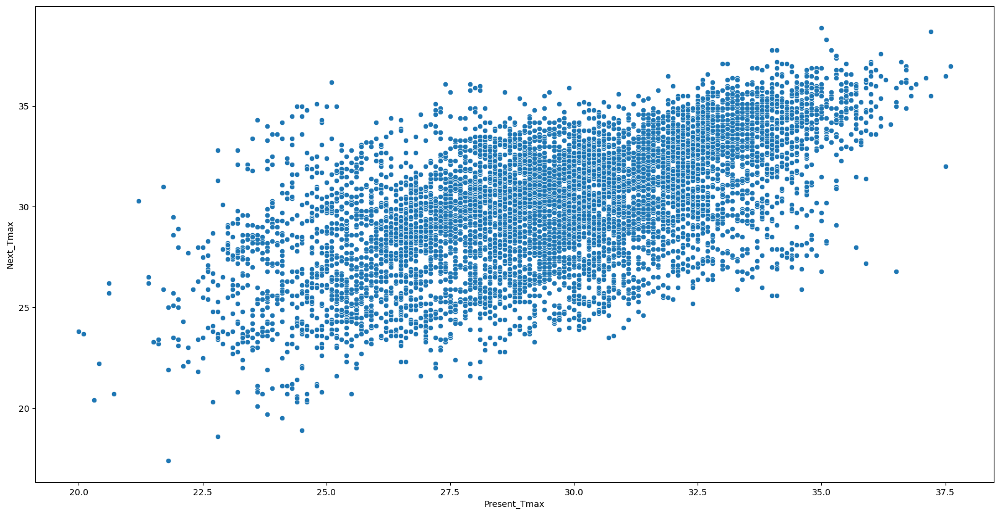

In [17]:
plt.figure(figsize = (20,10))
sns.scatterplot(x = 'Present_Tmax', y= 'Next_Tmax',data=df)
plt.show()


We see that as the present_Tmax increases there is increase in next_Tmax.

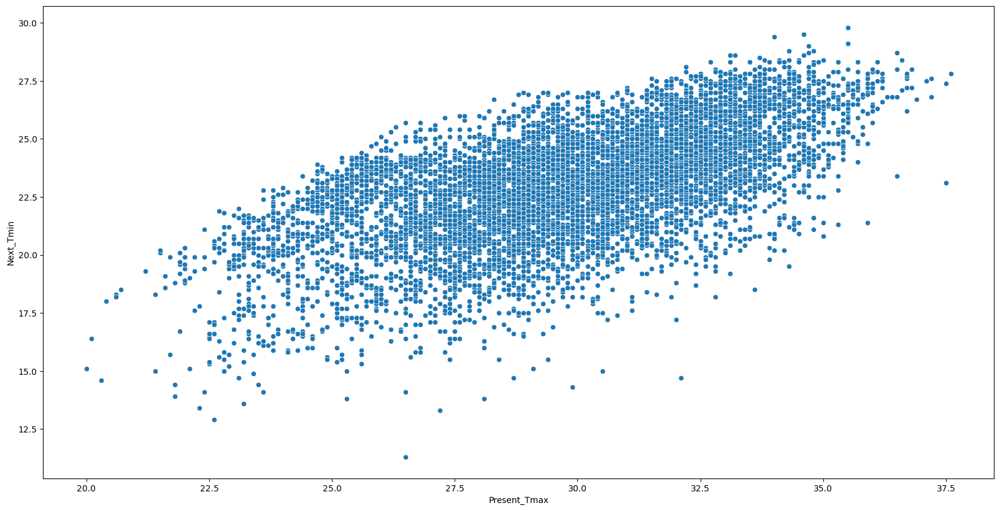

In [18]:
plt.figure(figsize = (20,10))
sns.scatterplot(x = 'Present_Tmax', y= 'Next_Tmin',data=df)
plt.show()


Here also we see linear relationship, they both are increasing.

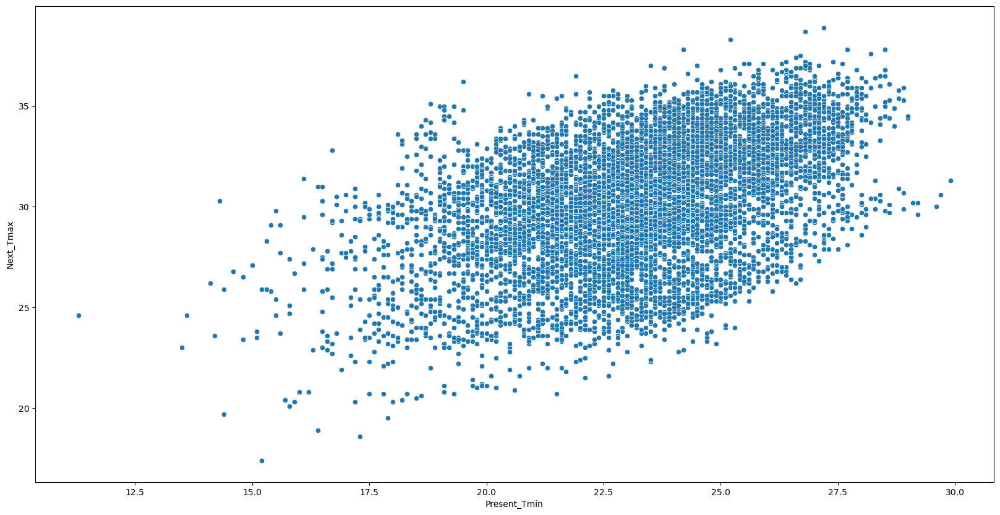

In [19]:
plt.figure(figsize = (20,10))
sns.scatterplot(x = 'Present_Tmin', y= 'Next_Tmax',data=df)
plt.show()


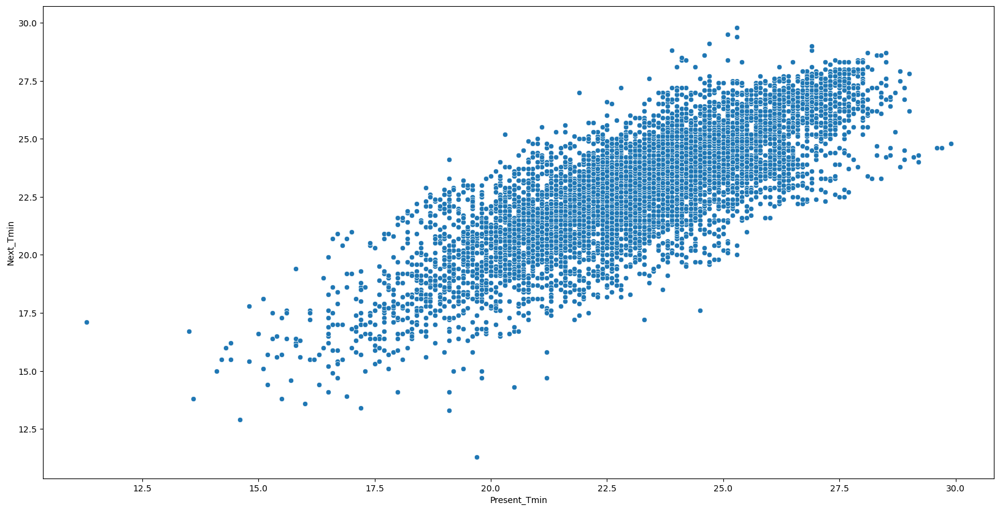

In [20]:
plt.figure(figsize = (20,10))
sns.scatterplot(x = 'Present_Tmin', y= 'Next_Tmin',data=df)
plt.show()


We see in all the present-Tmax and Present_Tmin there is linear relationship which means as the present_tmax and Present_tmin increase the Next_tmax and next_tmin are also increasing.

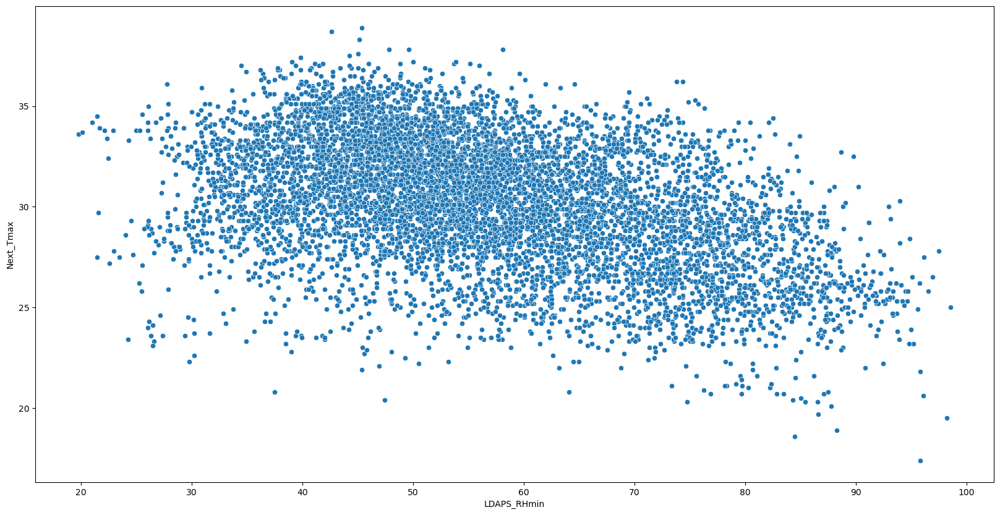

In [21]:
plt.figure(figsize = (20,10))
sns.scatterplot(x = 'LDAPS_RHmin', y= 'Next_Tmax',data=df)
plt.show()


AS the LDAPS_Rhmin increases the next_tmax is decreasing.

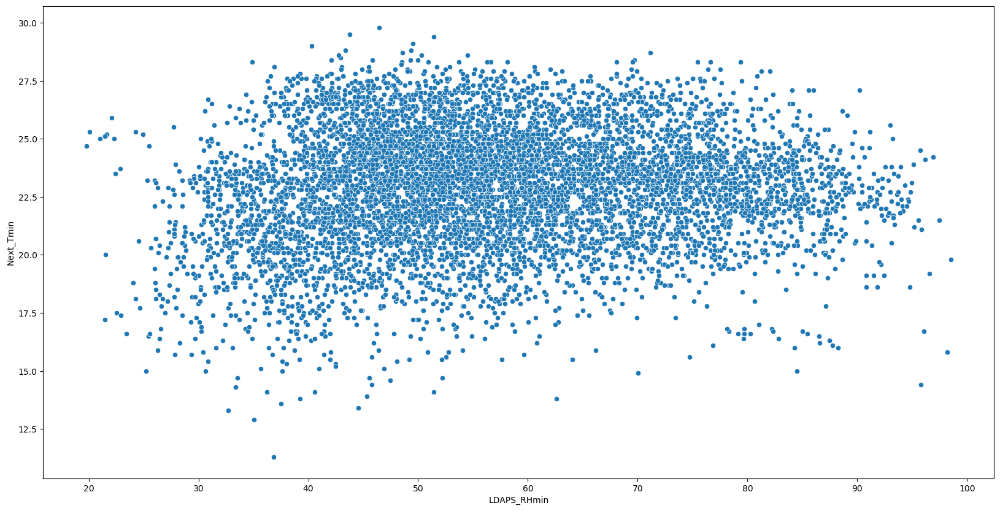

In [22]:
plt.figure(figsize = (20,10))
sns.scatterplot(x = 'LDAPS_RHmin', y= 'Next_Tmin',data=df)
plt.show()

There is no such relation as the next_tmin lies almost in some point, its not increasing or decreasing. 

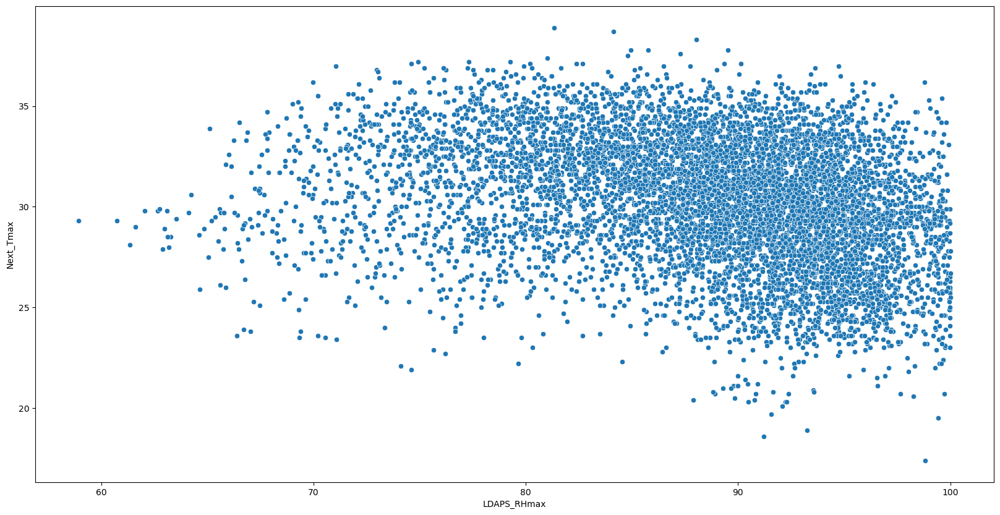

In [23]:
plt.figure(figsize = (20,10))
sns.scatterplot(x = 'LDAPS_RHmax', y= 'Next_Tmax',data=df)
plt.show()


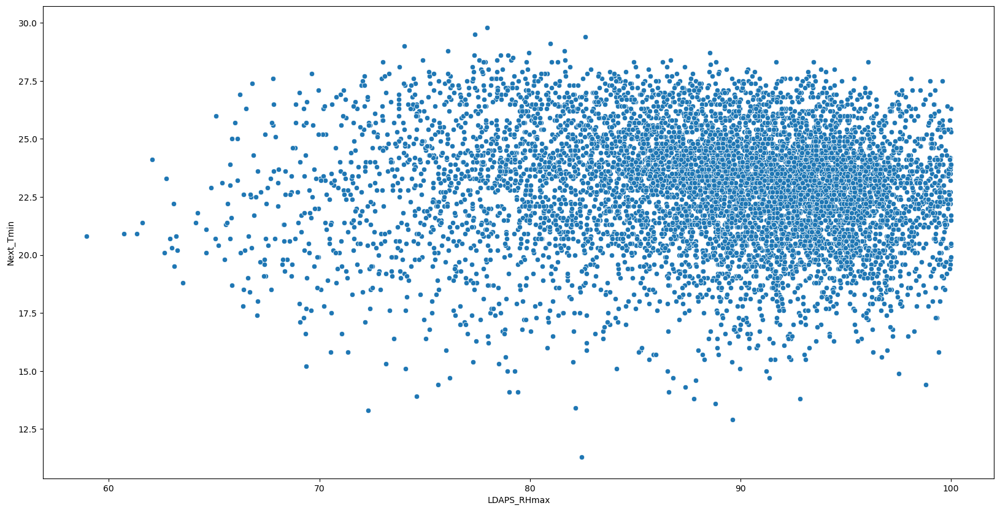

In [24]:
plt.figure(figsize = (20,10))
sns.scatterplot(x = 'LDAPS_RHmax', y= 'Next_Tmin',data=df)
plt.show()


We see that Next_Tmax and Next_Tmin are almost lieing at some point and there is no such increase or decrease in Next_Tmax and Next_Tmin with respect to LDAPS_RHmax and LDAPS_RHmin.

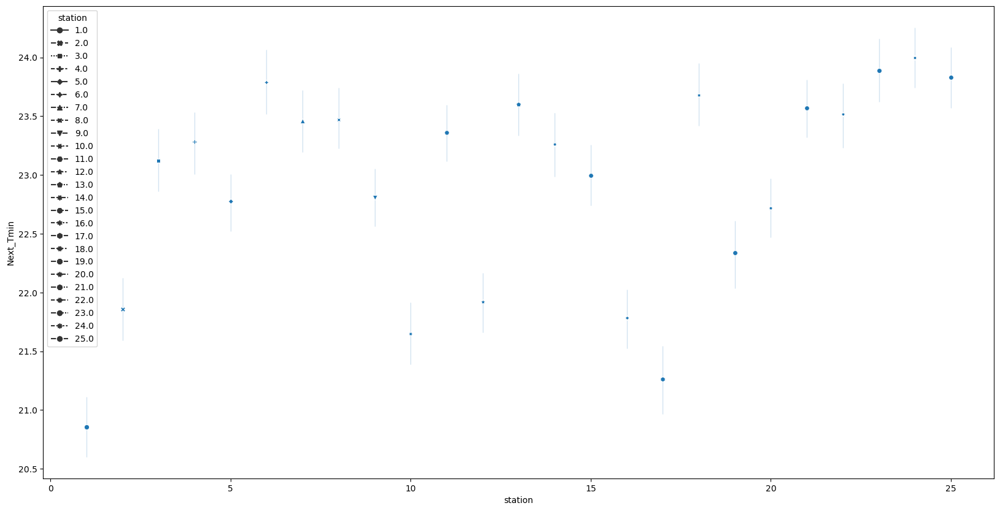

In [25]:
plt.figure(figsize = (20,10))
sns.lineplot(x = 'station', y= 'Next_Tmin',data=df, markers=True, style = 'station')
plt.show()


We see there is increase in next_tmin at the stations 23,324 and 25.

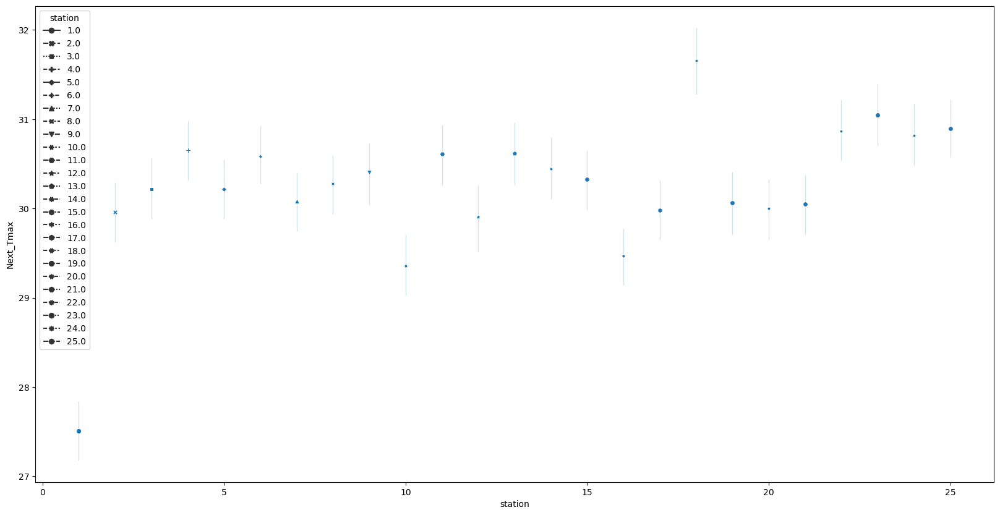

In [26]:
plt.figure(figsize = (20,10))
sns.lineplot(x = 'station', y= 'Next_Tmax',data=df, markers=True, style = 'station')
plt.show()

we see there is increase in next_Tmax at station 18 compared to all other stations.

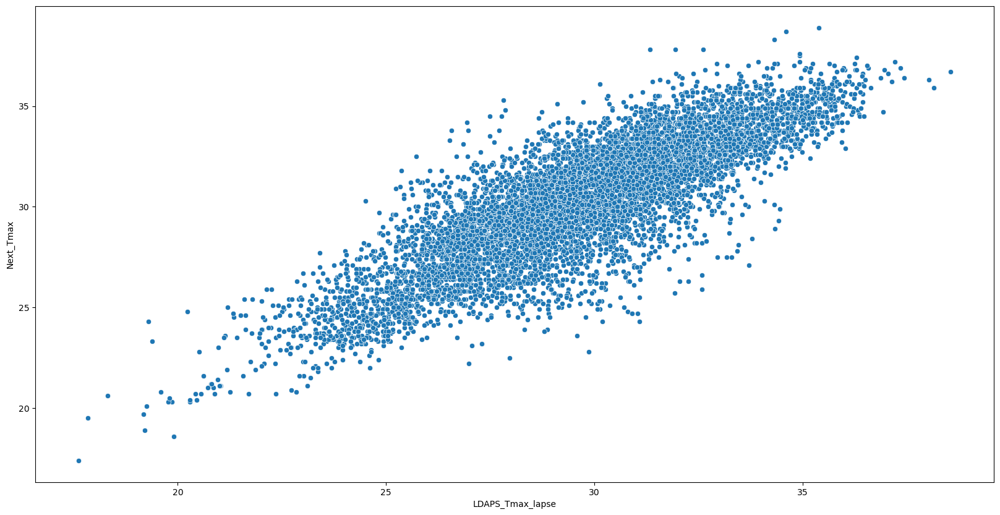

In [27]:
plt.figure(figsize = (20,10))
sns.scatterplot(x = 'LDAPS_Tmax_lapse', y= 'Next_Tmax',data=df)
plt.show()

We see there is a increase in Next_Tmax with increase in LDAPS_Tmax_lapse.

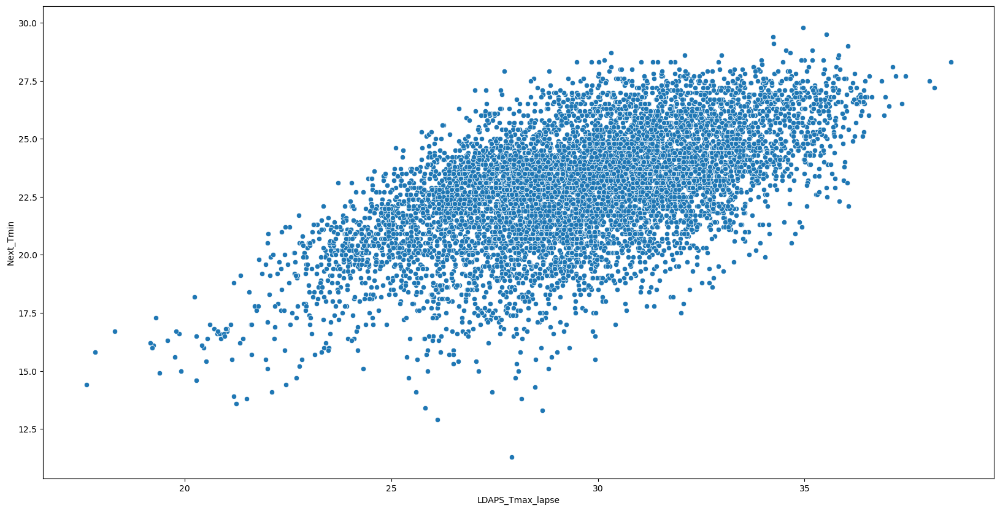

In [28]:
plt.figure(figsize = (20,10))
sns.scatterplot(x = 'LDAPS_Tmax_lapse', y= 'Next_Tmin',data=df)
plt.show()

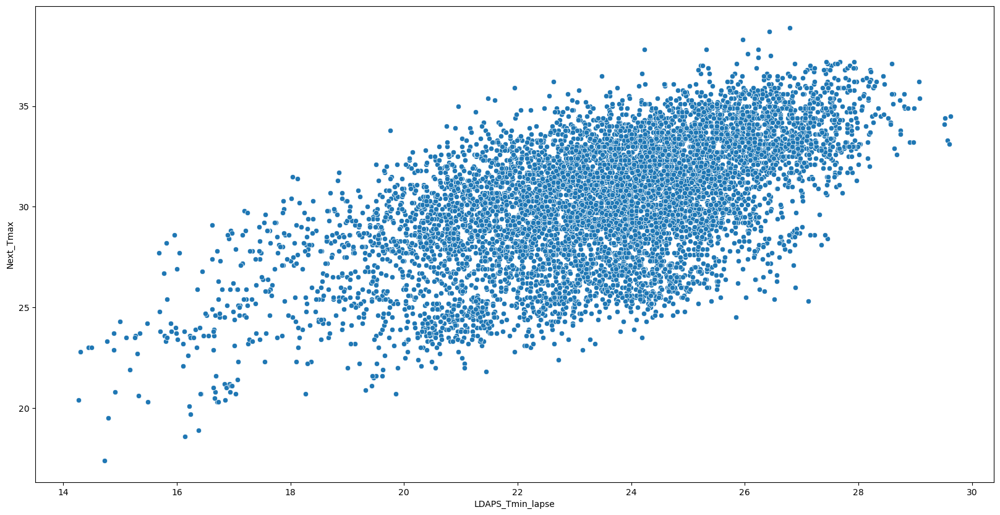

In [29]:
plt.figure(figsize = (20,10))
sns.scatterplot(x = 'LDAPS_Tmin_lapse', y= 'Next_Tmax',data=df)
plt.show()

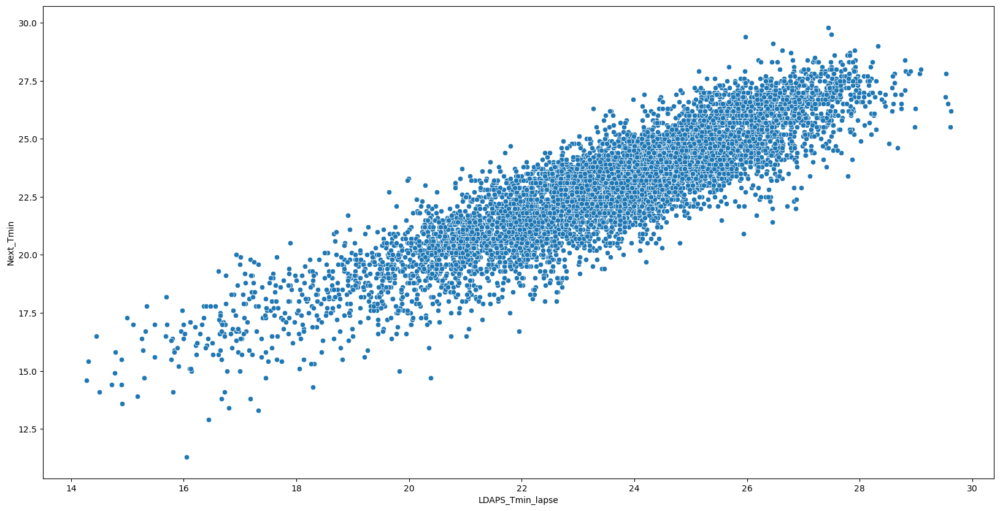

In [30]:
plt.figure(figsize = (20,10))
sns.scatterplot(x = 'LDAPS_Tmin_lapse', y= 'Next_Tmin',data=df)
plt.show()

We see in all the values of LDAPS_Tmax_lapse and LDAPS_Tmin_lapse, there is increase in the values of NExt_tmax and Next_tmin.

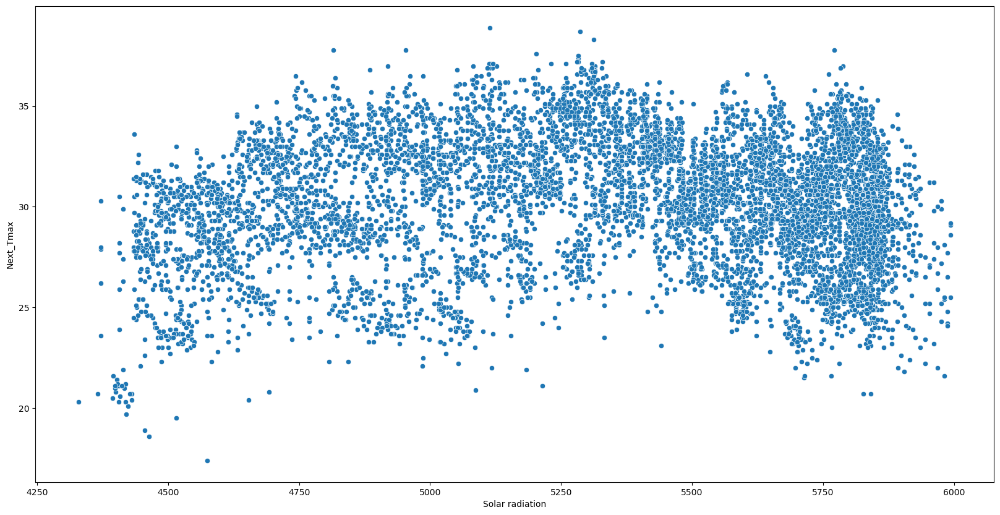

In [47]:
plt.figure(figsize = (20,10))
sns.scatterplot(x = 'Solar radiation', y= 'Next_Tmax',data=df)
plt.show()

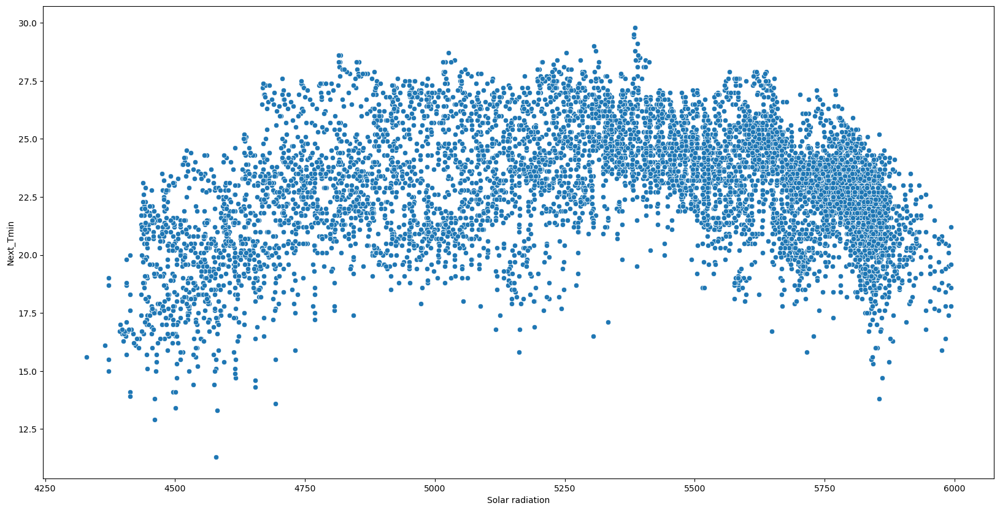

In [48]:
plt.figure(figsize = (20,10))
sns.scatterplot(x = 'Solar radiation', y= 'Next_Tmin',data=df)
plt.show()

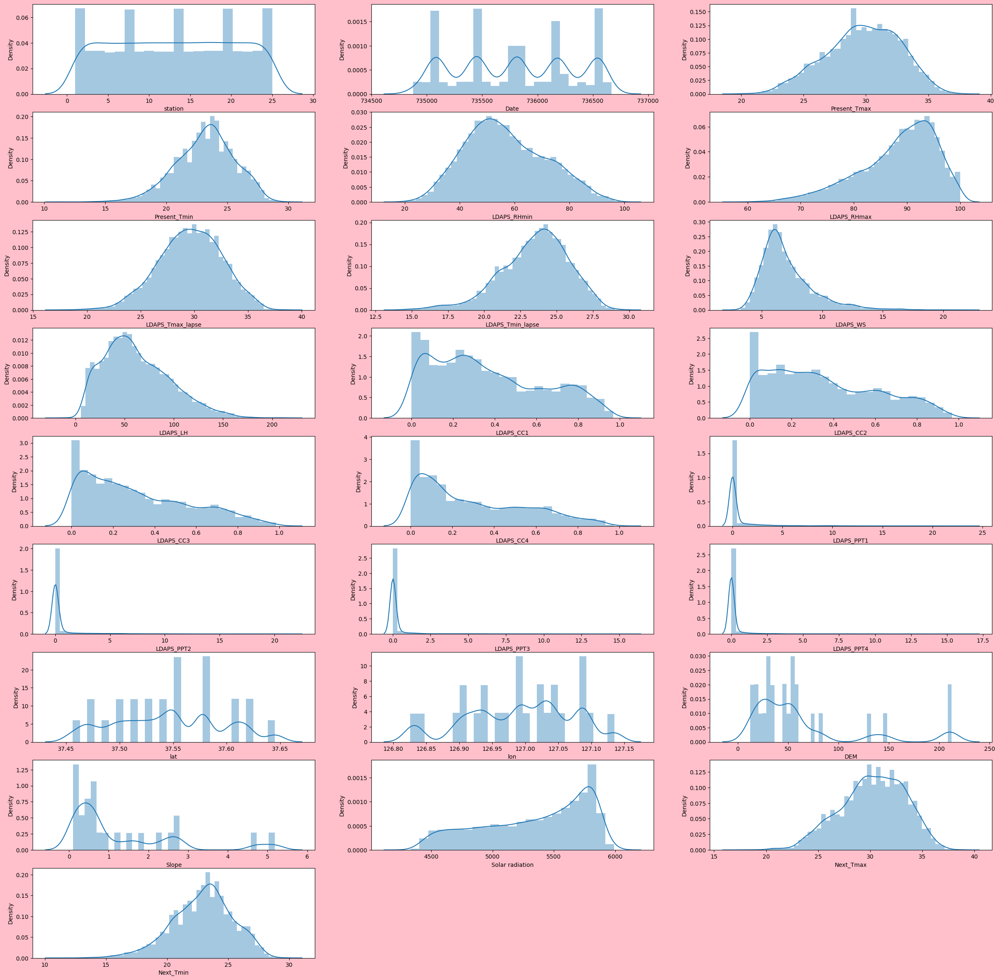

In [51]:
plt.figure(figsize =(30,30), facecolor = 'pink')
num = 1
for column in df:
    if num <=25:
        plt.subplot(9,3,num)
        sns.distplot(df[column])
        plt.xlabel(column,fontsize = 10)
        
    num +=1
plt.show()

we see there is skewness and outliers in most of the columns. so we will try to reduce this skewness and remove outliers then scale the data since all the values are in different scale.

### correlation

In [52]:
df.corr()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
station,1.000000,0.001605,0.113301,0.133282,-0.067846,-0.169351,0.069856,0.105277,0.005822,-0.132129,0.006539,0.003526,-0.000161,0.005005,-0.001954,-0.007635,-0.013865,-0.011085,-0.239118,-0.118845,-0.256706,-0.091721,-0.021194,0.107747,0.128184
Date,0.001605,1.000000,0.052709,0.034010,-0.010108,-0.148219,0.014606,-0.006857,-0.124121,0.051965,-0.075915,-0.056461,0.102016,0.097315,-0.095180,-0.051028,0.050371,0.026135,0.002070,-0.004052,0.002419,0.000446,-0.053738,0.054269,0.015578
Present_Tmax,0.113301,0.052709,1.000000,0.615208,-0.209059,-0.306943,0.573777,0.628705,-0.125952,0.134246,-0.316333,-0.216976,-0.146391,-0.143069,-0.114917,-0.104779,-0.127248,-0.107295,-0.054134,0.007695,-0.189439,-0.107079,-0.022114,0.610357,0.621048
Present_Tmin,0.133282,0.034010,0.615208,1.000000,0.122200,-0.018576,0.467904,0.772061,-0.038779,-0.012817,0.084348,0.090038,-0.004719,-0.046694,0.111577,0.066207,-0.052428,-0.070391,-0.081417,-0.045174,-0.254084,-0.148423,0.059765,0.463523,0.796975
LDAPS_RHmin,-0.067846,-0.010108,-0.209059,0.122200,1.000000,0.578358,-0.569580,0.085237,0.289422,-0.072195,0.612831,0.744774,0.688069,0.513937,0.259039,0.389572,0.237512,0.167311,0.085027,-0.077590,0.100684,0.122454,0.242168,-0.446824,0.093249
LDAPS_RHmax,-0.169351,-0.148219,-0.306943,-0.018576,0.578358,1.000000,-0.377293,-0.118965,0.131269,0.238986,0.435937,0.390620,0.224734,0.127242,0.268019,0.227581,0.132436,0.118101,0.194820,0.025563,0.176557,0.219436,0.146622,-0.289788,-0.076415
LDAPS_Tmax_lapse,0.069856,0.014606,0.573777,0.467904,-0.569580,-0.377293,1.000000,0.653425,-0.316011,0.043663,-0.440878,-0.525380,-0.542728,-0.429739,-0.115659,-0.248369,-0.193749,-0.170415,-0.044052,0.091568,-0.181433,-0.163891,0.047414,0.835729,0.589963
LDAPS_Tmin_lapse,0.105277,-0.006857,0.628705,0.772061,0.085237,-0.118965,0.653425,1.000000,-0.134652,-0.139675,0.008714,0.046537,-0.044998,-0.079536,0.034956,-0.002743,-0.093116,-0.103541,-0.099452,-0.024703,-0.198396,-0.187864,0.157763,0.592119,0.886513
LDAPS_WS,0.005822,-0.124121,-0.125952,-0.038779,0.289422,0.131269,-0.316011,-0.134652,1.000000,0.004427,0.285349,0.257226,0.238155,0.218870,0.141503,0.181634,0.147199,0.134428,0.033025,-0.063009,0.188540,0.169223,0.120630,-0.351107,-0.102021
LDAPS_LH,-0.132129,0.051965,0.134246,-0.012817,-0.072195,0.238986,0.043663,-0.139675,0.004427,1.000000,-0.148314,-0.265382,-0.246709,-0.173156,-0.018708,-0.084375,0.009495,0.012372,0.133309,0.024476,0.056362,0.087517,-0.044956,0.156779,-0.060392


In [53]:
df.corr().sum()

station             0.548534
Date                0.879836
Present_Tmax        2.065317
Present_Tmin        4.043595
LDAPS_RHmin         4.878643
LDAPS_RHmax         3.130730
LDAPS_Tmax_lapse    0.068728
LDAPS_Tmin_lapse    3.736808
LDAPS_WS            2.291068
LDAPS_LH            0.554788
LDAPS_CC1           3.889317
LDAPS_CC2           4.335825
LDAPS_CC3           3.983074
LDAPS_CC4           3.354014
LDAPS_PPT1          2.858530
LDAPS_PPT2          3.499313
LDAPS_PPT3          2.360816
LDAPS_PPT4          2.098885
lat                 1.246542
lon                 1.181693
DEM                 0.858295
Slope               1.521063
Solar radiation     2.681305
Next_Tmax           0.392807
Next_Tmin           3.803052
dtype: float64

Here we see that all the columes are having positive correlation , Present_Tmin, LDAPS_RHmin, LDAPS_CC2 has highest positive correlation with features.

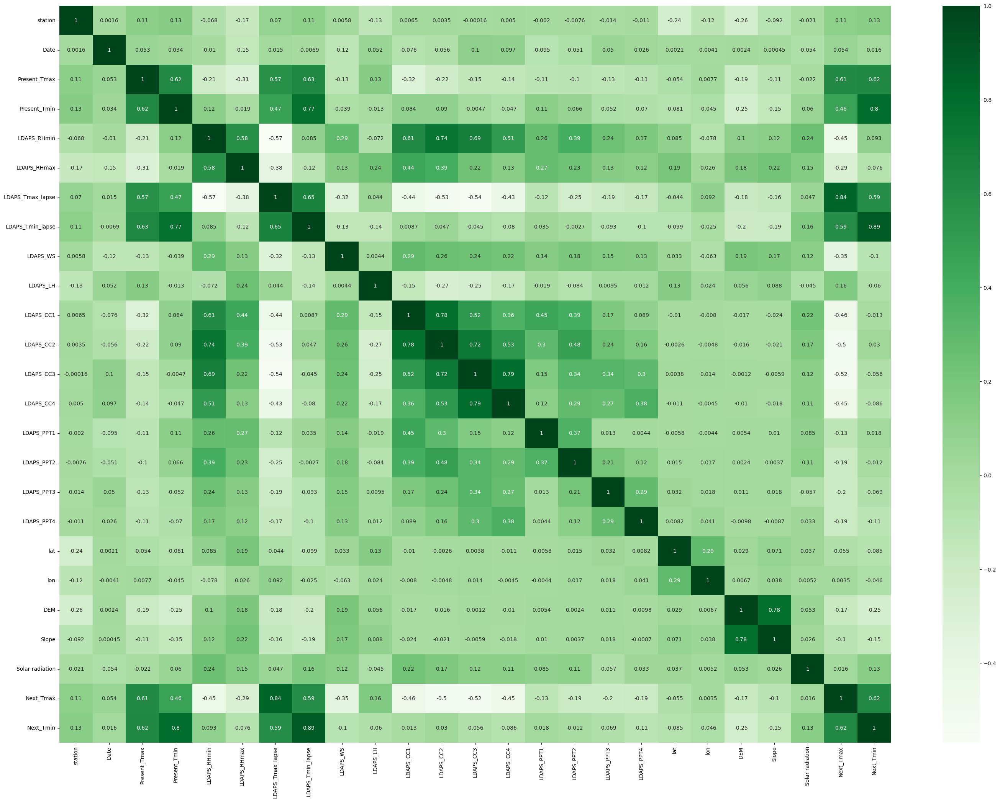

In [54]:
df_corr = df.corr()

plt.figure(figsize = (35,25))
sns.heatmap(df_corr,annot=True,annot_kws ={'size':10}, cmap = 'Greens')
plt.show()

We see  that
1. Next_Tmin is having highest positive correlation with Present_Tmax,Present_Tmin, LDAPS_Tmin_lapse and Next_Tmax.
2. Next_Tmax is having highest positive correlation with Present_Tmax, LDAPS_Tmax_lapse and Next_Tmin and least correlation with LDAPS_RHmin, LDAPS_CC1,LDAPS_CC2,LDAPS_CC3 and LDAPS_CC4

### Handling Outliers.

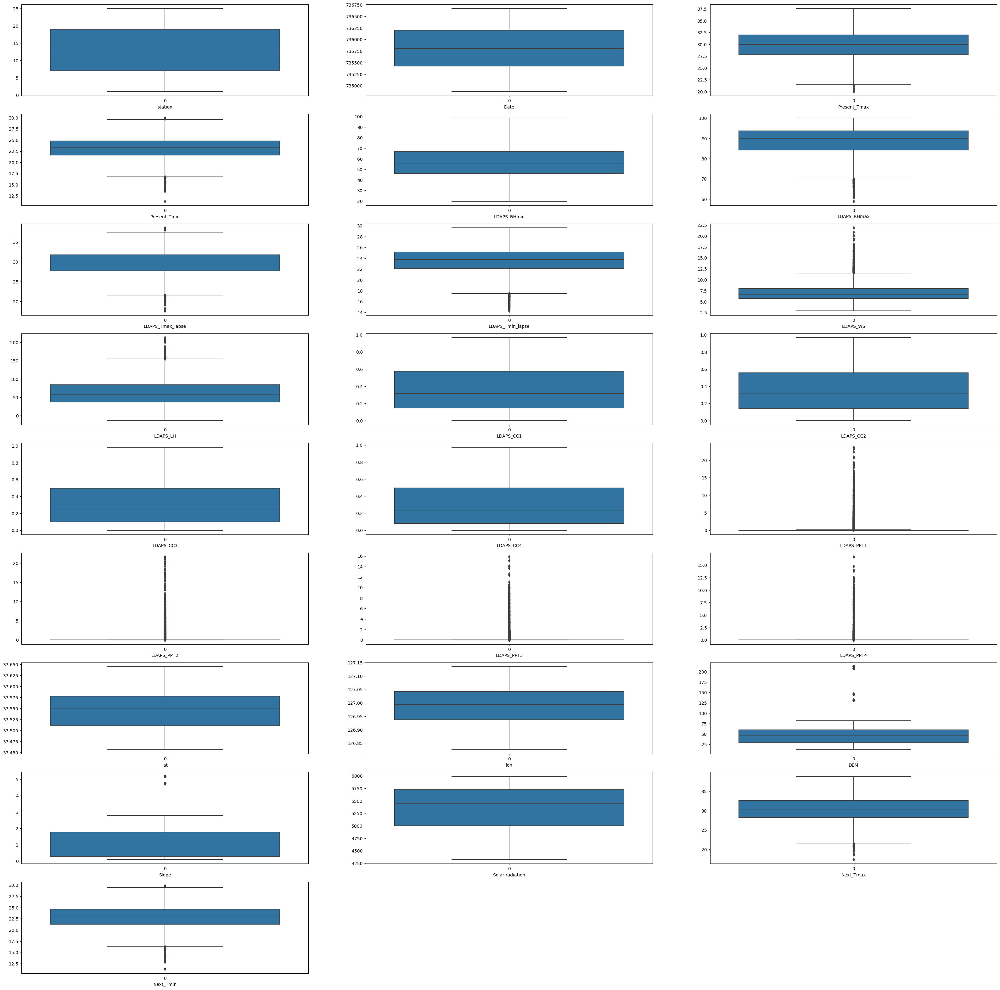

In [55]:
plt.figure(figsize =(40,40), facecolor = 'white')
num = 1
for column in df:
    if num <=25:
        plt.subplot(9,3,num)
        sns.boxplot(data = df[column])
        plt.xlabel(column,fontsize = 10)
        
    num +=1
plt.show()

We see there are huge outliers in the features like LDAPS_PPT1, LDAPS_PPT2, LDAPS_PPT3, LDAPS_PPT4. So, we will check there skewness if its high then we will drop those features.

In [56]:
df.skew()

station            -0.004178
Date                0.011103
Present_Tmax       -0.257069
Present_Tmin       -0.353822
LDAPS_RHmin         0.301396
LDAPS_RHmax        -0.845264
LDAPS_Tmax_lapse   -0.222349
LDAPS_Tmin_lapse   -0.574035
LDAPS_WS            1.553926
LDAPS_LH            0.662971
LDAPS_CC1           0.456716
LDAPS_CC2           0.473929
LDAPS_CC3           0.639649
LDAPS_CC4           0.663815
LDAPS_PPT1          5.305906
LDAPS_PPT2          5.710360
LDAPS_PPT3          6.356670
LDAPS_PPT4          6.681256
lat                 0.085377
lon                -0.289048
DEM                 1.721617
Slope               1.559050
Solar radiation    -0.524325
Next_Tmax          -0.334842
Next_Tmin          -0.393662
dtype: float64

Since the features like LDAPS_PPT1, LDAPS_PPT2, LDAPS_PPT3, LDAPS_PPT4 are also having skewness above 5. so we will drop these features. And then handle outliers and will treat the skewness.

In [57]:
df.drop(columns = ['LDAPS_PPT1', 'LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4'], axis=1, inplace=True)

In [58]:
## handle outliiers using z_score method
from scipy.stats import zscore
z = np.abs(zscore(df))
np.where(z>3) #threshold = 3
z_df=df[(z<3).all(axis=1)]
print(z_df.shape)
print("data_loss =   ", ((df.shape[0]-z_df.shape[0])/df.shape[0])*100)

(7313, 21)
data_loss =    3.624143384290986


In [59]:
# using IQR Method
q1 = df.quantile(0.25)
q3 = df.quantile(0.75)

iqr = q3-q1

iqr_df = df[~((df <(q1 - 1.5*iqr))| (df>(q3+1.5*iqr))).any(axis=1)]
print(iqr_df.shape)
print("data_loss =   ", ((df.shape[0]-iqr_df.shape[0])/df.shape[0])*100)

(5892, 21)
data_loss =    22.35108065366368


We see that after treating the outliers using z_score method the data loss is 3.6% and using IQR method is 22.3%, so we consider z-Score method as the best and will consider dataframe by z_score method.

In [60]:
z_df = df

In [61]:
### Skewness Handling
df.skew()

station            -0.004178
Date                0.011103
Present_Tmax       -0.257069
Present_Tmin       -0.353822
LDAPS_RHmin         0.301396
LDAPS_RHmax        -0.845264
LDAPS_Tmax_lapse   -0.222349
LDAPS_Tmin_lapse   -0.574035
LDAPS_WS            1.553926
LDAPS_LH            0.662971
LDAPS_CC1           0.456716
LDAPS_CC2           0.473929
LDAPS_CC3           0.639649
LDAPS_CC4           0.663815
lat                 0.085377
lon                -0.289048
DEM                 1.721617
Slope               1.559050
Solar radiation    -0.524325
Next_Tmax          -0.334842
Next_Tmin          -0.393662
dtype: float64

we see only very few features are having skewness like LDAPS_RHmax,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC3,LDAPS_CC4,DEM and Slope. So now we will reduce this skewness using cbrt method.

In [62]:
for index in df.skew().index:
    if df.skew().loc[index] >0.55:
        df[index] = np.cbrt(df[index])

In [63]:
df.skew()

station            -0.004178
Date                0.011103
Present_Tmax       -0.257069
Present_Tmin       -0.353822
LDAPS_RHmin         0.301396
LDAPS_RHmax        -0.845264
LDAPS_Tmax_lapse   -0.222349
LDAPS_Tmin_lapse   -0.574035
LDAPS_WS            0.877761
LDAPS_LH           -0.348066
LDAPS_CC1           0.456716
LDAPS_CC2           0.473929
LDAPS_CC3          -0.559701
LDAPS_CC4          -0.458425
lat                 0.085377
lon                -0.289048
DEM                 0.919265
Slope               0.612855
Solar radiation    -0.524325
Next_Tmax          -0.334842
Next_Tmin          -0.393662
dtype: float64

We see there is skewness in some of the features like LDAPS_RHmax,LDAPS_WS,DEM and Slope. so we will try to reduce using yeojohnson method.

In [64]:
from scipy.stats import yeojohnson

In [65]:
df['LDAPS_RHmax'] = yeojohnson(df['LDAPS_RHmax'])[0]
df['LDAPS_WS'] = yeojohnson(df['LDAPS_WS'])[0]
df['DEM'] = yeojohnson(df['DEM'])[0]
df['Slope'] = yeojohnson(df['Slope'])[0]

In [66]:
df.skew()

station            -0.004178
Date                0.011103
Present_Tmax       -0.257069
Present_Tmin       -0.353822
LDAPS_RHmin         0.301396
LDAPS_RHmax        -0.120174
LDAPS_Tmax_lapse   -0.222349
LDAPS_Tmin_lapse   -0.574035
LDAPS_WS            0.003999
LDAPS_LH           -0.348066
LDAPS_CC1           0.456716
LDAPS_CC2           0.473929
LDAPS_CC3          -0.559701
LDAPS_CC4          -0.458425
lat                 0.085377
lon                -0.289048
DEM                 0.047882
Slope               0.067989
Solar radiation    -0.524325
Next_Tmax          -0.334842
Next_Tmin          -0.393662
dtype: float64

We see that the skewness have been reduced.Next we will divide the dataset into features and label then scale the data and build the model

In [67]:
x= df.drop(columns = ['Next_Tmax','Next_Tmin'], axis = 1)
y_max = df['Next_Tmax']
y_min = df['Next_Tmin']

In [68]:
x

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,lat,lon,DEM,Slope,Solar radiation
0,1.0,735049,28.7,21.4,58.255688,2.885352e+09,28.074101,23.006936,0.270236,4.110499,0.233947,2.038957e-01,0.544796,0.507783,37.6046,126.991,0.775342,0.563926,5992.895996
1,2.0,735049,31.9,21.6,52.263397,2.803301e+09,29.850689,24.035009,0.269346,3.731014,0.225508,2.517714e-01,0.542254,0.503610,37.6046,127.032,0.716593,0.433610,5869.312500
2,3.0,735049,31.6,23.3,48.690479,1.899498e+09,30.091292,24.565633,0.269731,2.740099,0.209344,2.574694e-01,0.588764,0.521864,37.5776,127.058,0.702721,0.382973,5863.555664
3,4.0,735049,32.0,23.4,58.239788,3.868942e+09,29.704629,23.326177,0.269307,4.035663,0.216372,2.260024e-01,0.544189,0.512039,37.6450,127.022,0.717548,0.556900,5856.964844
4,5.0,735049,31.4,21.9,56.174095,2.732764e+09,29.113934,23.486480,0.269385,4.761697,0.151407,2.499953e-01,0.563461,0.553989,37.5507,127.135,0.705163,0.432298,5859.552246
5,6.0,735049,31.9,23.5,52.437126,2.059066e+09,29.219342,23.822613,0.269766,3.689706,0.185279,2.808180e-01,0.615205,0.527000,37.5102,127.042,0.725442,0.338338,5873.780762
6,7.0,735049,31.4,24.4,56.287189,1.581437e+09,28.551859,24.238467,0.269248,5.001466,0.389600,3.335700e-01,0.646665,0.526209,37.5776,126.838,0.649673,0.310577,5849.233398
7,8.0,735049,32.1,23.6,52.326218,1.302561e+09,28.851982,23.819054,0.269703,3.476345,0.357856,3.449281e-01,0.648230,0.523955,37.4697,126.910,0.723717,0.520147,5863.992188
8,9.0,735049,31.4,22.0,55.338791,1.558093e+09,28.426975,23.332373,0.269631,4.398742,0.408766,3.448003e-01,0.642299,0.530040,37.4967,126.826,0.722370,0.416534,5876.901367
9,10.0,735049,31.6,20.5,56.651203,2.256915e+09,27.576705,22.527018,0.270024,3.979185,0.348292,3.062548e-01,0.625949,0.513554,37.4562,126.955,0.774785,0.608843,5893.608398


### Standard Scaler

In [69]:
from sklearn.preprocessing import StandardScaler
sr = StandardScaler()
x = pd.DataFrame(sr.fit_transform(x), columns = x.columns)
x

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,lat,lon,DEM,Slope,Solar radiation
0,-1.664607,-1.433938,-0.353318,-0.748029,0.104660,0.271501,-0.525269,-0.215525,0.097458,0.374098,-0.513123,-0.587938,-0.316686,-0.347398,1.186076,-0.005302,1.836098,1.238303,1.510565
1,-1.526052,-1.433938,0.725138,-0.664721,-0.305052,0.184890,0.078334,0.223368,-0.617470,-0.128111,-0.545304,-0.402304,-0.328136,-0.365038,1.186076,0.512280,0.052890,-0.287329,1.222997
2,-1.387498,-1.433938,0.624033,0.043400,-0.549344,-0.769141,0.160080,0.449896,-0.308246,-1.439484,-0.606944,-0.380211,-0.118632,-0.287862,0.650626,0.840503,-0.368183,-0.880144,1.209602
3,-1.248943,-1.433938,0.758840,0.085054,0.103573,1.309753,0.028710,-0.079238,-0.648521,0.275061,-0.580143,-0.502221,-0.319418,-0.329400,1.987268,0.386040,0.081872,1.156044,1.194265
4,-1.110389,-1.433938,0.556630,-0.539758,-0.037665,0.110434,-0.171981,-0.010803,-0.585866,1.235891,-0.827872,-0.409191,-0.232609,-0.152038,0.117159,1.812547,-0.294057,-0.302688,1.200286
5,-0.971835,-1.433938,0.725138,0.126708,-0.293174,-0.600705,-0.136169,0.132694,-0.279734,-0.182778,-0.698710,-0.289679,0.000468,-0.266147,-0.686016,0.638519,0.321473,-1.402697,1.233395
6,-0.833280,-1.433938,0.556630,0.501595,-0.029932,-1.104878,-0.362949,0.310226,-0.695936,1.553201,0.080422,-0.085138,0.142177,-0.269489,0.650626,-1.936767,-1.978320,-1.727708,1.176275
7,-0.694726,-1.433938,0.792542,0.168362,-0.300757,-1.399252,-0.260981,0.131175,-0.330349,-0.465138,-0.040626,-0.041098,0.149227,-0.279021,-1.489192,-1.027842,0.269131,0.725776,1.210617
8,-0.556171,-1.433938,0.556630,-0.498104,-0.094778,-1.129520,-0.405379,-0.076593,-0.388367,0.755558,0.153505,-0.041594,0.122514,-0.253291,-0.953742,-2.088254,0.228226,-0.487241,1.240656
9,-0.417617,-1.433938,0.624033,-1.122916,-0.005044,-0.391860,-0.694262,-0.420405,-0.072658,0.200318,-0.077096,-0.191050,0.048863,-0.322996,-1.756917,-0.459764,1.819202,1.764155,1.279532


Now, dataset is scaled. Next we will check for Multicollinearity

#### Multi-Collinearity

In [70]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif['VIF Values']=[variance_inflation_factor(x.values, i) for i in range(len(x.columns))]
vif['Features'] = x.columns

vif

,VIF Values,Features
0,1.282724,station
1,1.107646,Date
2,2.711632,Present_Tmax
3,3.171314,Present_Tmin
4,6.461845,LDAPS_RHmin
5,2.575678,LDAPS_RHmax
6,7.265157,LDAPS_Tmax_lapse
7,7.078435,LDAPS_Tmin_lapse
8,1.189450,LDAPS_WS
9,1.458025,LDAPS_LH


We see that all the values are within range below 10. So, we consider there is no multicollinearity. Now we will build the model before that we will split datasset into train and test.

### Model Building- Next_Tmax

In [71]:
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.ensemble import GradientBoostingRegressor, AdaBoostRegressor
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.svm import SVR
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

In [72]:
accuracy = 0
r_state =0
for i in range(1,100):
    x_train_max,x_test_max,y_train_max,y_test_max = train_test_split(x, y_max, test_size = 0.25, random_state = i)
    lr = LinearRegression()
    lr.fit(x_train_max,y_train_max)
    y_pred = lr.predict(x_test_max)
    acc = r2_score(y_test_max,y_pred)
    if acc>accuracy:
        accuracy=acc
        r_state = i
print("maximum r2 score is ", accuracy , "at randomstate = ",r_state)

maximum r2 score is  0.8030436831103964 at randomstate =  30


In [73]:
x_train_max,x_test_max,y_train_max,y_test_max = train_test_split(x, y_max, test_size = 0.25, random_state = 30)

In [74]:
x_train_max.shape

(5691, 19)

In [75]:
x_test_max.shape

(1897, 19)

In [76]:
y_train_max.shape

(5691,)

In [77]:
y_test_max.shape

(1897,)

In [82]:
lr = LinearRegression()
lr.fit(x_train_max,y_train_max)
lr_pred = lr.predict(x_test_max)
lr_pred_train = lr.predict(x_train_max)
lr_r2_train = r2_score(y_train_max, lr_pred_train)
lr_r2 = r2_score(y_test_max, lr_pred)
lr_mae = mean_absolute_error(y_test_max, lr_pred)
lr_mse = mean_squared_error(y_test_max, lr_pred)
lr_rmse = np.sqrt(mean_squared_error(y_test_max, lr_pred))
print("Linear Regression")
print("r2Score of train data is  ",lr_r2_train)
print("r2Score of test data is  ",lr_r2)
print("Mean absolute error of test data is  ", lr_mae)
print("Mean squared error of test data is  ", lr_mse)
print("Root Mean squared error of test data is  ", lr_rmse)
print("\n\n")


ls = Lasso()
ls.fit(x_train_max,y_train_max)
ls_pred = ls.predict(x_test_max)
ls_pred_train = ls.predict(x_train_max)
ls_r2_train = r2_score(y_train_max, ls_pred_train)
ls_r2 = r2_score(y_test_max, ls_pred)
ls_mae = mean_absolute_error(y_test_max, ls_pred)
ls_mse = mean_squared_error(y_test_max, ls_pred)
ls_rmse = np.sqrt(mean_squared_error(y_test_max, ls_pred))
print("Lasso Regression")
print("r2Score of train data is  ",ls_r2_train)
print("r2Score of test data is  ",ls_r2)
print("Mean absolute error of test data is  ", ls_mae)
print("Mean squared error of test data is  ", ls_mse)
print("Root Mean squared error of test data is  ", ls_rmse)
print("\n\n")

rg = Ridge()
rg.fit(x_train_max,y_train_max)
rg_pred = rg.predict(x_test_max)
rg_pred_train = rg.predict(x_train_max)
rg_r2_train = r2_score(y_train_max, rg_pred_train)
rg_r2 = r2_score(y_test_max, rg_pred)
rg_mae = mean_absolute_error(y_test_max, rg_pred)
rg_mse = mean_squared_error(y_test_max, rg_pred)
rg_rmse = np.sqrt(mean_squared_error(y_test_max, rg_pred))
print("Ridge Regression")
print("r2Score of train data is  ",rg_r2_train)
print("r2Score of test data is  ",rg_r2)
print("Mean absolute error of test data is  ", rg_mae)
print("Mean squared error of test data is  ", rg_mse)
print("Root Mean squared error of test data is  ", rg_rmse)
print("\n\n")

gbr = GradientBoostingRegressor()
gbr.fit(x_train_max,y_train_max)
gbr_pred = gbr.predict(x_test_max)
gbr_pred_train = gbr.predict(x_train_max)
gbr_r2_train = r2_score(y_train_max, gbr_pred_train)
gbr_r2 = r2_score(y_test_max, gbr_pred)
gbr_mae = mean_absolute_error(y_test_max, gbr_pred)
gbr_mse = mean_squared_error(y_test_max, gbr_pred)
gbr_rmse = np.sqrt(mean_squared_error(y_test_max, gbr_pred))
print("Gradient Boosting Regressor")
print("r2Score of train data is  ",gbr_r2_train)
print("r2Score of test data is  ",gbr_r2)
print("Mean absolute error of test data is  ", gbr_mae)
print("Mean squared error of test data is  ", gbr_mse)
print("Root Mean squared error of test data is  ", gbr_rmse)
print("\n\n")

abr = AdaBoostRegressor()
abr.fit(x_train_max,y_train_max)
abr_pred = abr.predict(x_test_max)
abr_pred_train = abr.predict(x_train_max)
abr_r2_train = r2_score(y_train_max, abr_pred_train)
abr_r2 = r2_score(y_test_max, abr_pred)
abr_mae = mean_absolute_error(y_test_max, abr_pred)
abr_mse = mean_squared_error(y_test_max, abr_pred)
abr_rmse = np.sqrt(mean_squared_error(y_test_max, abr_pred))
print("Ada Boosting Regressor")
print("r2Score of train data is  ",abr_r2_train)
print("r2Score of test data is  ",abr_r2)
print("Mean absolute error of test data is  ", abr_mae)
print("Mean squared error of test data is  ", abr_mse)
print("Root Mean squared error of test data is  ", abr_rmse)
print("\n\n")

rfr = RandomForestRegressor()
rfr.fit(x_train_max,y_train_max)
rfr_pred = rfr.predict(x_test_max)
rfr_pred_train = rfr.predict(x_train_max)
rfr_r2_train = r2_score(y_train_max, rfr_pred_train)
rfr_r2 = r2_score(y_test_max, rfr_pred)
rfr_mae = mean_absolute_error(y_test_max, rfr_pred)
rfr_mse = mean_squared_error(y_test_max, rfr_pred)
rfr_rmse = np.sqrt(mean_squared_error(y_test_max, rfr_pred))
print("Random Forest Regressor")
print("r2Score of train data is  ",rfr_r2_train)
print("r2Score of test data is  ",rfr_r2)
print("Mean absolute error of test data is  ", rfr_mae)
print("Mean squared error of test data is  ", rfr_mse)
print("Root Mean squared error of test data is  ", rfr_rmse)
print("\n\n")

etr = ExtraTreesRegressor()
etr.fit(x_train_max,y_train_max)
etr_pred = etr.predict(x_test_max)
etr_pred_train = etr.predict(x_train_max)
etr_r2_train = r2_score(y_train_max, etr_pred_train)
etr_r2 = r2_score(y_test_max, etr_pred)
etr_mae = mean_absolute_error(y_test_max, etr_pred)
etr_mse = mean_squared_error(y_test_max, etr_pred)
etr_rmse = np.sqrt(mean_squared_error(y_test_max, etr_pred))
print("Extra Trees Regressor")
print("r2Score of train data is  ",etr_r2_train)
print("r2Score of test data is  ",etr_r2)
print("Mean absolute error of test data is  ", etr_mae)
print("Mean squared error of test data is  ", etr_mse)
print("Root Mean squared error of test data is  ", etr_rmse)
print("\n\n")

dtr = DecisionTreeRegressor()
dtr.fit(x_train_max,y_train_max)
dtr_pred = dtr.predict(x_test_max)
dtr_pred_train = dtr.predict(x_train_max)
dtr_r2_train = r2_score(y_train_max, dtr_pred_train)
dtr_r2 = r2_score(y_test_max, dtr_pred)
dtr_mae = mean_absolute_error(y_test_max, dtr_pred)
dtr_mse = mean_squared_error(y_test_max, dtr_pred)
dtr_rmse = np.sqrt(mean_squared_error(y_test_max, dtr_pred))
print("Decision Tree Regressor")
print("r2Score of train data is  ",dtr_r2_train)
print("r2Score of test data is  ",dtr_r2)
print("Mean absolute error of test data is  ", dtr_mae)
print("Mean squared error of test data is  ", dtr_mse)
print("Root Mean squared error of test data is  ", dtr_rmse)
print("\n\n")

knn = KNN()
knn.fit(x_train_max,y_train_max)
knn_pred = knn.predict(x_test_max)
knn_pred_train = knn.predict(x_train_max)
knn_r2_train = r2_score(y_train_max, knn_pred_train)
knn_r2 = r2_score(y_test_max, knn_pred)
knn_mae = mean_absolute_error(y_test_max, knn_pred)
knn_mse = mean_squared_error(y_test_max, knn_pred)
knn_rmse = np.sqrt(mean_squared_error(y_test_max, knn_pred))
print("K-Nearest Neighbor")
print("r2Score of train data is  ",knn_r2_train)
print("r2Score of test data is  ",knn_r2)
print("Mean absolute error of test data is  ", knn_mae)
print("Mean squared error of test data is  ", knn_mse)
print("Root Mean squared error of test data is  ", knn_rmse)
print("\n\n")


svr = SVR()
svr.fit(x_train_max,y_train_max)
svr_pred = svr.predict(x_test_max)
svr_pred_train = svr.predict(x_train_max)
svr_r2_train = r2_score(y_train_max, svr_pred_train)
svr_r2 = r2_score(y_test_max, svr_pred)
svr_mae = mean_absolute_error(y_test_max, svr_pred)
svr_mse = mean_squared_error(y_test_max, svr_pred)
svr_rmse = np.sqrt(mean_squared_error(y_test_max, svr_pred))
print("Super Vector Regressor")
print("r2Score of train data is  ",svr_r2_train)
print("r2Score of test data is  ",svr_r2)
print("Mean absolute error of test data is  ", svr_mae)
print("Mean squared error of test data is  ", svr_mse)
print("Root Mean squared error of test data is  ", svr_rmse)
print("\n\n")

Linear Regression
r2Score of train data is   0.7595822364955938
r2Score of test data is   0.8030436831103964
Mean absolute error of test data is   1.0681090703680425
Mean squared error of test data is   1.9651661916909893
Root Mean squared error of test data is   1.4018438542473228



Lasso Regression
r2Score of train data is   0.5800248001131805
r2Score of test data is   0.6109171935510362
Mean absolute error of test data is   1.5719214639356878
Mean squared error of test data is   3.8821419341951184
Root Mean squared error of test data is   1.9703151865108075



Ridge Regression
r2Score of train data is   0.7595821405514667
r2Score of test data is   0.8030381886846741
Mean absolute error of test data is   1.0680885596401788
Mean squared error of test data is   1.965221013287182
Root Mean squared error of test data is   1.4018634074998826



Gradient Boosting Regressor
r2Score of train data is   0.8788628680247008
r2Score of test data is   0.8780881758577932
Mean absolute error of tes

In [83]:
accuracy_max = pd.DataFrame({'Models':['Linear','Lasso','Ridge', 'GradientBoosting','AdaBoostRegressor','ExtraTreesRegressor','RandomForest','DecisionTree', 'Knn','svr'],
                          'r-square_train':[lr_r2_train, ls_r2_train,rg_r2_train,gbr_r2_train,abr_r2_train, etr_r2_train, rfr_r2_train, dtr_r2_train,knn_r2_train,svr_r2_train],
                          'r-square_test':[lr_r2, ls_r2,rg_r2,gbr_r2,abr_r2, etr_r2, rfr_r2, dtr_r2,knn_r2,svr_r2],    
                          'mae_score':[lr_mae, ls_mae,rg_mae,gbr_mae,abr_mae, etr_mae, rfr_mae, dtr_mae,knn_mae,svr_mae],
                          'mse_score':[lr_mse, ls_mse,rg_mse,gbr_mse,abr_mse,etr_mse,rfr_mse, dtr_mse,knn_mse,svr_mse],
                          'rmse_score':[lr_rmse, ls_rmse,rg_rmse,gbr_rmse,abr_rmse,etr_rmse,rfr_rmse,dtr_rmse,knn_rmse,svr_rmse]})
accuracy_max

,Models,r-square_train,r-square_test,mae_score,mse_score,rmse_score
0,Linear,0.759582,0.803044,1.068109,1.965166,1.401844
1,Lasso,0.580025,0.610917,1.571921,3.882142,1.970315
2,Ridge,0.759582,0.803038,1.068089,1.965221,1.401863
3,GradientBoosting,0.878863,0.878088,0.861680,1.216397,1.102904
4,AdaBoostRegressor,0.772596,0.782188,1.191667,2.173260,1.474198
5,ExtraTreesRegressor,1.000000,0.933806,0.618827,0.660459,0.812686
6,RandomForest,0.986998,0.923497,0.665349,0.763321,0.873682
7,DecisionTree,1.000000,0.799820,1.004428,1.997333,1.413270
8,Knn,0.883449,0.840736,0.964576,1.589082,1.260588
9,svr,0.877433,0.881573,0.808126,1.181624,1.087025


#### Cross-validation Scoe

In [85]:
#linear Regression
lr_score = cross_val_score(lr, x, y_max, cv=5)
print("Linear Regression")
print(lr_score)
lr_mean = np.mean(lr_score)
print(lr_mean)
lr_diff = (lr_r2 - lr_score.mean())
print(lr_diff)
print("\n")

#Lasso Regression
ls_score = cross_val_score(ls, x, y_max, cv=5)
print("Lasso Regression")
print(ls_score)
ls_mean = np.mean(ls_score)
print(ls_mean)
ls_diff = (ls_r2 - ls_score.mean())
print(ls_diff)
print("\n")

#Ridge Regression
rg_score = cross_val_score(rg, x, y_max, cv=5)
print("Ridge Regression")
print(rg_score)
rg_mean = np.mean(rg_score)
print(rg_mean)
rg_diff = (rg_r2 - rg_score.mean())
print(rg_diff)
print("\n")

#Gradient Boosting Regression
gbr_score = cross_val_score(gbr, x, y_max, cv=5)
print("Gradient Boosting Regression")
print(gbr_score)
gbr_mean = np.mean(gbr_score)
print(gbr_mean)
gbr_diff = (gbr_r2 - gbr_score.mean())
print(gbr_diff)
print("\n")

#AdaBoost Regression
abr_score = cross_val_score(abr, x, y_max, cv=5)
print("Ada Boosting Regression")
print(abr_score)
abr_mean = np.mean(abr_score)
print(abr_mean)
abr_diff = (abr_r2 - abr_score.mean())
print(abr_diff)
print("\n")

#Extra Trees Regression
etr_score = cross_val_score(etr, x, y_max, cv=5)
print("Extra Trees Regression")
print(etr_score)
etr_mean = np.mean(etr_score)
print(etr_mean)
etr_diff = (etr_r2 - etr_score.mean())
print(etr_diff)
print("\n")

#Random Forest Regression
rfr_score = cross_val_score(rfr, x, y_max, cv=5)
print("Random forest Regression")
print(rfr_score)
rfr_mean = np.mean(rfr_score)
print(rfr_mean)
rfr_diff = (rfr_r2 - rfr_score.mean())
print(rfr_diff)
print("\n")

#Decision trees Regression
dtr_score = cross_val_score(dtr, x, y_max, cv=5)
print("Decision trees Regression")
print(dtr_score)
dtr_mean = np.mean(dtr_score)
print(dtr_mean)
dtr_diff = (dtr_r2 - dtr_score.mean())
print(dtr_diff)
print("\n")

#KNN Regression
knn_score = cross_val_score(knn, x, y_max, cv=5)
print("KNN Regression")
print(knn_score)
knn_mean = np.mean(knn_score)
print(knn_mean)
knn_diff = (knn_r2 - knn_score.mean())
print(knn_diff)
print("\n")

#Super Vector Regression
svr_score = cross_val_score(svr, x, y_max, cv=5)
print("Super Vector Regression")
print(svr_score)
svr_mean = np.mean(svr_score)
print(svr_mean)
svr_diff = (svr_r2 - svr_score.mean())
print(svr_diff)
print("\n")

Linear Regression
[0.65993678 0.65562759 0.68119662 0.81920222 0.61922508]
0.6870376582749969
0.11600602483539957


Lasso Regression
[0.53448225 0.53491041 0.5721042  0.53622744 0.59652384]
0.5548496266355715
0.05606756691546477


Ridge Regression
[0.66010622 0.65554471 0.68116741 0.81926124 0.61933879]
0.6870836731993009
0.11595451548537328


Gradient Boosting Regression
[0.75101259 0.6962527  0.68598586 0.84639492 0.6193747 ]
0.7198041535869851
0.15828402227080807


Ada Boosting Regression
[0.72842509 0.65390627 0.65610915 0.77065032 0.66259974]
0.6943381126471968
0.08784963421091851


Extra Trees Regression
[0.75102575 0.64122058 0.6551955  0.82891062 0.63751736]
0.7027739614796837
0.23103235586636706


Random forest Regression
[0.73876741 0.6571083  0.64369677 0.81640445 0.43492144]
0.6581796733752758
0.26531745037269894


Decision trees Regression
[0.36064214 0.40721255 0.3568109  0.61775385 0.21226155]
0.390936199030082
0.4088836430962843


KNN Regression
[0.63647634 0.44818526 0

In [86]:
Cross_val_max = pd.DataFrame({'Models':['Linear','Lasso','Ridge', 'GradientBoosting','Ada Boost','ExtraTrees Regressor','RandomForest','DecisionTree', 'Knn','svr'],
                                'r-square_train':[lr_r2_train, ls_r2_train,rg_r2_train,gbr_r2_train,abr_r2_train, etr_r2_train, rfr_r2_train, dtr_r2_train,knn_r2_train,svr_r2_train],
                               'r-square_test':[lr_r2, ls_r2,rg_r2,gbr_r2,abr_r2, etr_r2, rfr_r2, dtr_r2,knn_r2,svr_r2], 
                               'CV_mean':[lr_mean, ls_mean,rg_mean,gbr_mean,abr_mean, etr_mean, rfr_mean, dtr_mean,knn_mean,svr_mean], 
                              'diff_cv_r2':[lr_diff, ls_diff,rg_diff,gbr_diff,abr_diff,etr_diff,rfr_diff, dtr_diff,knn_diff,svr_diff]})
Cross_val_max

,Models,r-square_train,r-square_test,CV_mean,diff_cv_r2
0,Linear,0.759582,0.803044,0.687038,0.116006
1,Lasso,0.580025,0.610917,0.554850,0.056068
2,Ridge,0.759582,0.803038,0.687084,0.115955
3,GradientBoosting,0.878863,0.878088,0.719804,0.158284
4,Ada Boost,0.772596,0.782188,0.694338,0.087850
5,ExtraTrees Regressor,1.000000,0.933806,0.702774,0.231032
6,RandomForest,0.986998,0.923497,0.658180,0.265317
7,DecisionTree,1.000000,0.799820,0.390936,0.408884
8,Knn,0.883449,0.840736,0.572411,0.268326
9,svr,0.877433,0.881573,0.688912,0.192661


### Hyper-parameter Tuning with Lasso and AdaBoost Regressor for Next_Tmax

In [87]:
param_grid_lasso = {"alpha":[0.1,0.01,0.2], "fit_intercept":['True','False'], "copy_X":['True','False'],
                "max_iter":[1100,150,200], "random_state":[4,6,10], "selection":['cyclic','random'] }


In [88]:
gd_lasso = GridSearchCV(Lasso(), param_grid_lasso, cv=5)
gd_lasso.fit(x_train_max,y_train_max)
best_parameters=gd_lasso.best_params_
print(best_parameters)
best_result=gd_lasso.best_score_
print(best_result*100)

{'alpha': 0.01, 'copy_X': 'True', 'fit_intercept': 'True', 'max_iter': 1100, 'random_state': 4, 'selection': 'cyclic'}
75.7255582666132


In [96]:
max_temp1 = Lasso(alpha = 0.01,copy_X='True', fit_intercept='True', max_iter= 1100, random_state=4, selection='cyclic')

In [97]:
max_temp1.fit(x_train_max,y_train_max)
max_temp1_pred = max_temp1.predict(x_test_max)
max_temp1_r2 = r2_score(y_test_max, max_temp1_pred)
max_temp1_mae = mean_absolute_error(y_test_max, max_temp1_pred)
max_temp1_mse = mean_squared_error(y_test_max, max_temp1_pred)
max_temp1_rmse = np.sqrt(mean_squared_error(y_test_max, max_temp1_pred))

print("r2Score of test data is  ",max_temp1_r2)
print("Mean absolute error of test data is  ", max_temp1_mae)
print("Mean squared error of test data is  ", max_temp1_mse)
print("Root Mean squared error of test data is  ", max_temp1_rmse)
print("\n")

r2Score of test data is   0.8026883929698548
Mean absolute error of test data is   1.0682413793776373
Mean squared error of test data is   1.968711161374925
Root Mean squared error of test data is   1.403107679893074




#### AdaBoost Regressor

In [99]:
param_grid_ada = {"learning_rate":[0.1,0.01,0.2], "n_estimators":[60,70,90], "loss":['linear','square','exponential'],"random_state":[4,6,10]}

In [100]:
gd_ada = GridSearchCV(AdaBoostRegressor(), param_grid_ada, cv=5)
gd_ada.fit(x_train_max,y_train_max)
best_parameters=gd_ada.best_params_
print(best_parameters)
best_result=gd_ada.best_score_
print(best_result*100)

{'learning_rate': 0.2, 'loss': 'square', 'n_estimators': 90, 'random_state': 6}
75.67305129768988


In [108]:
max_temp2 = AdaBoostRegressor(learning_rate = 0.2,n_estimators=90, loss='square' ,random_state=6)

In [109]:
max_temp2.fit(x_train_max,y_train_max)
max_temp2_pred = max_temp2.predict(x_test_max)
max_temp2_r2 = r2_score(y_test_max, max_temp2_pred)
max_temp2_mae = mean_absolute_error(y_test_max, max_temp2_pred)
max_temp2_mse = mean_squared_error(y_test_max, max_temp2_pred)
max_temp2_rmse = np.sqrt(mean_squared_error(y_test_max, max_temp2_pred))

print("r2Score of test data is  ",max_temp2_r2)
print("Mean absolute error of test data is  ", max_temp2_mae)
print("Mean squared error of test data is  ", max_temp2_mse)
print("Root Mean squared error of test data is  ", max_temp2_rmse)
print("\n")

r2Score of test data is   0.7765891502981496
Mean absolute error of test data is   1.2111734113828643
Mean squared error of test data is   2.229120932115725
Root Mean squared error of test data is   1.4930240895965896




#### We see that using Lasso regression our r2 score is high and mae, mse, rmse have been reduced and its also less compared to Ada Boost regression.
#### After Tuning the parameters for Lasso regression the r2 score has increased to 80% whereas earlier it was 61%  before tuning the parameters. So we will save the model with Lasso Regression.

,Actual,Predicted
5803,36.1,31.862843
3046,30.5,30.274296
5908,35.1,32.059728
5677,37.0,35.838683
1192,33.9,32.876340
7670,27.1,26.804854
1831,29.0,28.679338
1660,30.2,31.700000
6551,27.5,30.525523
3692,25.5,28.386576


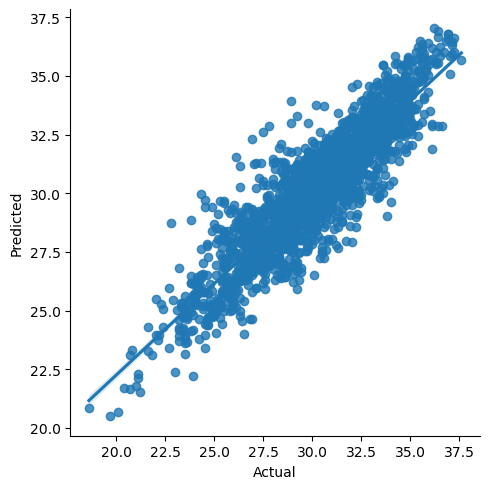

In [110]:
#### Predictions
next_Tmax_df = pd.DataFrame({'Actual':y_test_max , 'Predicted':max_temp1_pred},columns=['Actual','Predicted'])
sns.lmplot(x='Actual',y='Predicted', data=next_Tmax_df)
next_Tmax_df.head(25)

### Save the Model

In [111]:
import joblib
joblib.dump(max_temp1,'Next_Tmax_prediction.pkl')

['Next_Tmax_prediction.pkl']

In [113]:
next_tmax_model = joblib.load('Next_Tmax_prediction.pkl')
result = max_temp1.score(x_test_max,y_test_max)
print(result)


0.8026883929698548


### Model_Building Next_Tmin

In [114]:
accuracy = 0
r_state =0
for i in range(1,100):
    x_train_min,x_test_min,y_train_min,y_test_min = train_test_split(x, y_min, test_size = 0.25, random_state = i)
    lr = LinearRegression()
    lr.fit(x_train_min,y_train_min)
    y_pred_min = lr.predict(x_test_min)
    acc = r2_score(y_test_min,y_pred_min)
    if acc>accuracy:
        accuracy=acc
        r_state = i
print("maximum r2 score is ", accuracy , "at randomstate = ",r_state)

maximum r2 score is  0.8431184386438417 at randomstate =  60


In [115]:
x_train_min,x_test_min,y_train_min,y_test_min = train_test_split(x, y_min, test_size = 0.25, random_state = 60)

In [116]:
x_train_min.shape

(5691, 19)

In [117]:
x_test_min.shape

(1897, 19)

In [118]:
y_train_min.shape

(5691,)

In [119]:
y_test_min.shape

(1897,)

In [120]:
li = LinearRegression()
li.fit(x_train_min,y_train_min)
lr_pred_min = li.predict(x_test_min)
lr_pred_train_min = li.predict(x_train_min)
lr_r2_train_min = r2_score(y_train_min, lr_pred_train_min)
lr_r2_min = r2_score(y_test_min, lr_pred_min)
lr_mae_min = mean_absolute_error(y_test_min, lr_pred_min)
lr_mse_min = mean_squared_error(y_test_min, lr_pred_min)
lr_rmse_min = np.sqrt(mean_squared_error(y_test_min, lr_pred_min))
print("Linear Regression")
print("r2Score of train data is  ",lr_r2_train_min)
print("r2Score of test data is  ",lr_r2_min)
print("Mean absolute error of test data is  ", lr_mae_min)
print("Mean squared error of test data is  ", lr_mse_min)
print("Root Mean squared error of test data is  ", lr_rmse_min)
print("\n\n")


lso = Lasso()
lso.fit(x_train_min,y_train_min)
ls_pred_min = lso.predict(x_test_min)
ls_pred_train_min = lso.predict(x_train_min)
ls_r2_train_min = r2_score(y_train_min, ls_pred_train_min)
ls_r2_min = r2_score(y_test_min, ls_pred_min)
ls_mae_min = mean_absolute_error(y_test_min, ls_pred_min)
ls_mse_min = mean_squared_error(y_test_min, ls_pred_min)
ls_rmse_min = np.sqrt(mean_squared_error(y_test_min, ls_pred_min))
print("Lasso Regression")
print("r2Score of train data is  ",ls_r2_train_min)
print("r2Score of test data is  ",ls_r2_min)
print("Mean absolute error of test data is  ", ls_mae_min)
print("Mean squared error of test data is  ", ls_mse_min)
print("Root Mean squared error of test data is  ", ls_rmse_min)
print("\n\n")

rge = Ridge()
rge.fit(x_train_min,y_train_min)
rg_pred_min = rge.predict(x_test_min)
rg_pred_train_min = rge.predict(x_train_min)
rg_r2_train_min = r2_score(y_train_min, rg_pred_train_min)
rg_r2_min = r2_score(y_test_min, rg_pred_min)
rg_mae_min = mean_absolute_error(y_test_min, rg_pred_min)
rg_mse_min = mean_squared_error(y_test_min, rg_pred_min)
rg_rmse_min = np.sqrt(mean_squared_error(y_test_min, rg_pred_min))
print("Ridge Regression")
print("r2Score of train data is  ",rg_r2_train_min)
print("r2Score of test data is  ",rg_r2_min)
print("Mean absolute error of test data is  ", rg_mae_min)
print("Mean squared error of test data is  ", rg_mse_min)
print("Root Mean squared error of test data is  ", rg_rmse_min)
print("\n\n")

gbr1 = GradientBoostingRegressor()
gbr1.fit(x_train_min,y_train_min)
gbr_pred_min = gbr1.predict(x_test_min)
gbr_pred_train_min = gbr1.predict(x_train_min)
gbr_r2_train_min = r2_score(y_train_min, gbr_pred_train_min)
gbr_r2_min = r2_score(y_test_min, gbr_pred_min)
gbr_mae_min = mean_absolute_error(y_test_min, gbr_pred_min)
gbr_mse_min = mean_squared_error(y_test_min, gbr_pred_min)
gbr_rmse_min = np.sqrt(mean_squared_error(y_test_min, gbr_pred_min))
print("Gradient Boosting Regressor")
print("r2Score of train data is  ",gbr_r2_train_min)
print("r2Score of test data is  ",gbr_r2_min)
print("Mean absolute error of test data is  ", gbr_mae_min)
print("Mean squared error of test data is  ", gbr_mse_min)
print("Root Mean squared error of test data is  ", gbr_rmse_min)
print("\n\n")

abr1 = AdaBoostRegressor()
abr1.fit(x_train_min,y_train_min)
abr_pred_min = abr1.predict(x_test_min)
abr_pred_train_min = abr1.predict(x_train_min)
abr_r2_train_min = r2_score(y_train_min, abr_pred_train_min)
abr_r2_min = r2_score(y_test_min, abr_pred_min)
abr_mae_min = mean_absolute_error(y_test_min, abr_pred_min)
abr_mse_min = mean_squared_error(y_test_min, abr_pred_min)
abr_rmse_min = np.sqrt(mean_squared_error(y_test_min, abr_pred_min))
print("Ada Boosting Regressor")
print("r2Score of train data is  ",abr_r2_train_min)
print("r2Score of test data is  ",abr_r2_min)
print("Mean absolute error of test data is  ", abr_mae_min)
print("Mean squared error of test data is  ", abr_mse_min)
print("Root Mean squared error of test data is  ", abr_rmse_min)
print("\n\n")

rfr1 = RandomForestRegressor()
rfr1.fit(x_train_min,y_train_min)
rfr_pred_min = rfr1.predict(x_test_min)
rfr_pred_train_min = rfr1.predict(x_train_min)
rfr_r2_train_min = r2_score(y_train_min, rfr_pred_train_min)
rfr_r2_min = r2_score(y_test_min, rfr_pred_min)
rfr_mae_min = mean_absolute_error(y_test_min, rfr_pred_min)
rfr_mse_min = mean_squared_error(y_test_min, rfr_pred_min)
rfr_rmse_min = np.sqrt(mean_squared_error(y_test_min, rfr_pred_min))
print("Random Forest Regressor")
print("r2Score of train data is  ",rfr_r2_train)
print("r2Score of test data is  ",rfr_r2)
print("Mean absolute error of test data is  ", rfr_mae)
print("Mean squared error of test data is  ", rfr_mse)
print("Root Mean squared error of test data is  ", rfr_rmse)
print("\n\n")

etr1 = ExtraTreesRegressor()
etr1.fit(x_train_min,y_train_min)
etr_pred_min = etr1.predict(x_test_min)
etr_pred_train_min = etr1.predict(x_train_min)
etr_r2_train_min = r2_score(y_train_min, etr_pred_train_min)
etr_r2_min = r2_score(y_test_min, etr_pred_min)
etr_mae_min = mean_absolute_error(y_test_min, etr_pred_min)
etr_mse_min = mean_squared_error(y_test_min, etr_pred_min)
etr_rmse_min = np.sqrt(mean_squared_error(y_test_min, etr_pred_min))
print("Extra Trees Regressor")
print("r2Score of train data is  ",etr_r2_train_min)
print("r2Score of test data is  ",etr_r2_min)
print("Mean absolute error of test data is  ", etr_mae_min)
print("Mean squared error of test data is  ", etr_mse_min)
print("Root Mean squared error of test data is  ", etr_rmse_min)
print("\n\n")

dtr1 = DecisionTreeRegressor()
dtr1.fit(x_train_min,y_train_min)
dtr_pred_min = dtr1.predict(x_test_min)
dtr_pred_train_min = dtr1.predict(x_train_min)
dtr_r2_train_min = r2_score(y_train_min, dtr_pred_train_min)
dtr_r2_min = r2_score(y_test_min, dtr_pred_min)
dtr_mae_min = mean_absolute_error(y_test_min, dtr_pred_min)
dtr_mse_min = mean_squared_error(y_test_min, dtr_pred_min)
dtr_rmse_min = np.sqrt(mean_squared_error(y_test_min, dtr_pred_min))
print("Decision Tree Regressor")
print("r2Score of train data is  ",dtr_r2_train_min)
print("r2Score of test data is  ",dtr_r2_min)
print("Mean absolute error of test data is  ", dtr_mae_min)
print("Mean squared error of test data is  ", dtr_mse_min)
print("Root Mean squared error of test data is  ", dtr_rmse_min)
print("\n\n")

knn1 = KNN()
knn1.fit(x_train_min,y_train_min)
knn_pred_min = knn1.predict(x_test_min)
knn_pred_train_min = knn1.predict(x_train_min)
knn_r2_train_min = r2_score(y_train_min, knn_pred_train)
knn_r2_min = r2_score(y_test_min, knn_pred_min)
knn_mae_min = mean_absolute_error(y_test_min, knn_pred_min)
knn_mse_min = mean_squared_error(y_test_min, knn_pred_min)
knn_rmse_min = np.sqrt(mean_squared_error(y_test_min, knn_pred_min))
print("K-Nearest Neighbor")
print("r2Score of train data is  ",knn_r2_train_min)
print("r2Score of test data is  ",knn_r2_min)
print("Mean absolute error of test data is  ", knn_mae_min)
print("Mean squared error of test data is  ", knn_mse_min)
print("Root Mean squared error of test data is  ", knn_rmse_min)
print("\n\n")


svr1 = SVR()
svr1.fit(x_train_min,y_train_min)
svr_pred_min = svr1.predict(x_test_min)
svr_pred_train_min = svr1.predict(x_train_min)
svr_r2_train_min = r2_score(y_train_min, svr_pred_train_min)
svr_r2_min = r2_score(y_test_min, svr_pred_min)
svr_mae_min = mean_absolute_error(y_test_min, svr_pred_min)
svr_mse_min = mean_squared_error(y_test_min, svr_pred_min)
svr_rmse_min = np.sqrt(mean_squared_error(y_test_min, svr_pred_min))
print("Super Vector Regressor")
print("r2Score of train data is  ",svr_r2_train_min)
print("r2Score of test data is  ",svr_r2_min)
print("Mean absolute error of test data is  ", svr_mae_min)
print("Mean squared error of test data is  ", svr_mse_min)
print("Root Mean squared error of test data is  ", svr_rmse_min)
print("\n\n")

Linear Regression
r2Score of train data is   0.8258331689865275
r2Score of test data is   0.8431184386438417
Mean absolute error of test data is   0.7864224944916957
Mean squared error of test data is   1.0068883827745336
Root Mean squared error of test data is   1.0034382805008655



Lasso Regression
r2Score of train data is   0.6254655602850032
r2Score of test data is   0.6298990607100331
Mean absolute error of test data is   1.209452212339897
Mean squared error of test data is   2.3753609602278627
Root Mean squared error of test data is   1.541220607255127



Ridge Regression
r2Score of train data is   0.8258331199015103
r2Score of test data is   0.843121836374793
Mean absolute error of test data is   0.7864247510937211
Mean squared error of test data is   1.006866575649508
Root Mean squared error of test data is   1.003427414240566



Gradient Boosting Regressor
r2Score of train data is   0.9067372762785028
r2Score of test data is   0.897163936409012
Mean absolute error of test dat

In [121]:
accuracy_min = pd.DataFrame({'Models':['Linear','Lasso','Ridge', 'GradientBoosting','AdaBoostRegressor','ExtraTreesRegressor','RandomForest','DecisionTree', 'Knn','svr'],
                          'r-square_train':[lr_r2_train_min, ls_r2_train_min,rg_r2_train_min,gbr_r2_train_min,abr_r2_train_min, etr_r2_train_min, rfr_r2_train_min, dtr_r2_train_min,knn_r2_train_min,svr_r2_train_min],
                          'r-square_test':[lr_r2_min, ls_r2_min,rg_r2_min,gbr_r2_min,abr_r2_min, etr_r2_min, rfr_r2_min, dtr_r2_min,knn_r2_min,svr_r2_min],    
                          'mae_score':[lr_mae_min, ls_mae_min,rg_mae_min,gbr_mae_min,abr_mae_min, etr_mae_min, rfr_mae_min, dtr_mae_min,knn_mae_min,svr_mae_min],
                          'mse_score':[lr_mse_min, ls_mse_min,rg_mse_min,gbr_mse_min,abr_mse_min,etr_mse_min,rfr_mse_min, dtr_mse_min,knn_mse_min,svr_mse_min],
                          'rmse_score':[lr_rmse_min, ls_rmse_min,rg_rmse_min,gbr_rmse_min,abr_rmse_min,etr_rmse_min,rfr_rmse_min,dtr_rmse_min,knn_rmse_min,svr_rmse_min]})
accuracy_min

,Models,r-square_train,r-square_test,mae_score,mse_score,rmse_score
0,Linear,0.825833,0.843118,0.786422,1.006888,1.003438
1,Lasso,0.625466,0.629899,1.209452,2.375361,1.541221
2,Ridge,0.825833,0.843122,0.786425,1.006867,1.003427
3,GradientBoosting,0.906737,0.897164,0.629728,0.660017,0.812414
4,AdaBoostRegressor,0.813803,0.812386,0.881881,1.204132,1.097330
5,ExtraTreesRegressor,1.000000,0.920152,0.539113,0.512474,0.715873
6,RandomForest,0.986484,0.915584,0.553059,0.541794,0.736067
7,DecisionTree,1.000000,0.786676,0.863943,1.369146,1.170105
8,Knn,-10.207573,0.858049,0.735245,0.911065,0.954497
9,svr,0.917695,0.901719,0.596342,0.630783,0.794219


In [123]:
#linear Regression
li_score = cross_val_score(li, x, y_min, cv=5)
print("Linear Regression")
print(li_score)
li_mean = np.mean(li_score)
print(li_mean)
li_diff = (lr_r2_min - li_score.mean())
print(li_diff)
print("\n")

#Lasso Regression
lso_score = cross_val_score(lso, x, y_min, cv=5)
print("Lasso Regression")
print(lso_score)
lso_mean = np.mean(lso_score)
print(lso_mean)
lso_diff = (ls_r2_min - lso_score.mean())
print(lso_diff)
print("\n")

#Ridge Regression
rge_score = cross_val_score(rge, x, y_max, cv=5)
print("Ridge Regression")
print(rge_score)
rge_mean = np.mean(rge_score)
print(rge_mean)
rge_diff = (rg_r2_min - rge_score.mean())
print(rge_diff)
print("\n")

#Gradient Boosting Regression
gbr1_score = cross_val_score(gbr1, x, y_min, cv=5)
print("Gradient Boosting Regression")
print(gbr1_score)
gbr1_mean = np.mean(gbr1_score)
print(gbr1_mean)
gbr1_diff = (gbr_r2_min - gbr1_score.mean())
print(gbr1_diff)
print("\n")

#AdaBoost Regression
abr1_score = cross_val_score(abr1, x, y_min, cv=5)
print("Ada Boosting Regression")
print(abr1_score)
abr1_mean = np.mean(abr1_score)
print(abr1_mean)
abr1_diff = (abr_r2_min - abr1_score.mean())
print(abr1_diff)
print("\n")

#Extra Trees Regression
etr1_score = cross_val_score(etr1, x, y_min, cv=5)
print("Extra Trees Regression")
print(etr1_score)
etr1_mean = np.mean(etr1_score)
print(etr1_mean)
etr1_diff = (etr_r2_min - etr1_score.mean())
print(etr1_diff)
print("\n")

#Random Forest Regression
rfr1_score = cross_val_score(rfr1, x, y_min, cv=5)
print("Random forest Regression")
print(rfr1_score)
rfr1_mean = np.mean(rfr1_score)
print(rfr1_mean)
rfr1_diff = (rfr_r2_min - rfr1_score.mean())
print(rfr1_diff)
print("\n")

#Decision trees Regression
dtr1_score = cross_val_score(dtr1, x, y_min, cv=5)
print("Decision trees Regression")
print(dtr1_score)
dtr1_mean = np.mean(dtr1_score)
print(dtr1_mean)
dtr1_diff = (dtr_r2_min - dtr1_score.mean())
print(dtr1_diff)
print("\n")

#KNN Regression
knn1_score = cross_val_score(knn1, x, y_min, cv=5)
print("KNN Regression")
print(knn1_score)
knn1_mean = np.mean(knn1_score)
print(knn1_mean)
knn1_diff = (knn_r2_min - knn1_score.mean())
print(knn1_diff)
print("\n")

#Super Vector Regression
svr1_score = cross_val_score(svr1, x, y_min, cv=5)
print("Super Vector Regression")
print(svr1_score)
svr1_mean = np.mean(svr1_score)
print(svr1_mean)
svr1_diff = (svr_r2_min - svr1_score.mean())
print(svr1_diff)
print("\n")

Linear Regression
[0.70740294 0.64431893 0.79604043 0.88113367 0.85684974]
0.7771491424692031
0.06596929617463865


Lasso Regression
[0.55581432 0.44443511 0.60446913 0.55658817 0.66371992]
0.5650053289043253
0.06489373180570779


Ridge Regression
[0.66010622 0.65554471 0.68116741 0.81926124 0.61933879]
0.6870836731993009
0.15603816317549213


Gradient Boosting Regression
[0.64343648 0.6789989  0.83174731 0.88855654 0.89180151]
0.7869081496455295
0.11025578676348258


Ada Boosting Regression
[0.67243559 0.60815002 0.75422341 0.84298896 0.85404631]
0.7463688584729375
0.06601736169957162


Extra Trees Regression
[0.69161412 0.6869585  0.81931271 0.88719607 0.88579202]
0.794174685276374
0.12597755320396142


Random forest Regression
[0.52515545 0.67858509 0.82144594 0.88278783 0.87411091]
0.7564170471775408
0.1591669561818102


Decision trees Regression
[-0.3642497   0.47974849  0.63700128  0.77665887  0.68720388]
0.4432725627876993
0.34340313133913475


KNN Regression
[0.52368266 0.52912

In [124]:
Cross_val_min = pd.DataFrame({'Models':['Linear','Lasso','Ridge', 'GradientBoosting','Ada Boost','ExtraTrees Regressor','RandomForest','DecisionTree', 'Knn','svr'],
                               'r-square_train':[lr_r2_train_min, ls_r2_train_min,rg_r2_train_min,gbr_r2_train_min,abr_r2_train_min, etr_r2_train_min, rfr_r2_train_min, dtr_r2_train_min,knn_r2_train_min,svr_r2_train_min],
                          'r-square_test':[lr_r2_min, ls_r2_min,rg_r2_min,gbr_r2_min,abr_r2_min, etr_r2_min, rfr_r2_min, dtr_r2_min,knn_r2_min,svr_r2_min],    
                          'CV_mean':[li_mean, lso_mean,rge_mean,gbr1_mean,abr1_mean, etr1_mean, rfr1_mean, dtr1_mean,knn1_mean,svr1_mean], 
                              'diff_cv_r2':[li_diff, lso_diff,rge_diff,gbr1_diff,abr1_diff,etr1_diff,rfr1_diff, dtr1_diff,knn1_diff,svr1_diff]})
Cross_val_min



,Models,r-square_train,r-square_test,CV_mean,diff_cv_r2
0,Linear,0.825833,0.843118,0.777149,0.065969
1,Lasso,0.625466,0.629899,0.565005,0.064894
2,Ridge,0.825833,0.843122,0.687084,0.156038
3,GradientBoosting,0.906737,0.897164,0.786908,0.110256
4,Ada Boost,0.813803,0.812386,0.746369,0.066017
5,ExtraTrees Regressor,1.000000,0.920152,0.794175,0.125978
6,RandomForest,0.986484,0.915584,0.756417,0.159167
7,DecisionTree,1.000000,0.786676,0.443273,0.343403
8,Knn,-10.207573,0.858049,0.661870,0.196178
9,svr,0.917695,0.901719,0.728834,0.172885


We see that Linear and Lasso are having least difference. So we will tune the parameters for these models using GridSearchCV 

### Hyper-parameter Tuning using GridSearch CV for  Linear and lasso Regression

#### Linear Regression

In [130]:
param_grid_lin = {"fit_intercept":['True','False'], "copy_X":['True','False'],"positive":['True','False'],"n_jobs":[-1] }

In [131]:
gd_lin = GridSearchCV(LinearRegression(), param_grid_lin, cv=5)
gd_lin.fit(x_train_min,y_train_min)
best_parameters=gd_lin.best_params_
print(best_parameters)
best_result=gd_lin.best_score_
print(best_result*100)


{'copy_X': 'True', 'fit_intercept': 'True', 'n_jobs': -1, 'positive': 'True'}
81.70098758467017


In [132]:
min_temp1 = LinearRegression(copy_X='True', fit_intercept='True', n_jobs= -1,  positive='True')


In [133]:
min_temp1.fit(x_train_min,y_train_min)
min_temp1_pred = min_temp1.predict(x_test_min)
min_temp1_r2 = r2_score(y_test_min, min_temp1_pred)
min_temp1_mae = mean_absolute_error(y_test_min, min_temp1_pred)
min_temp1_mse = mean_squared_error(y_test_min, min_temp1_pred)
min_temp1_rmse = np.sqrt(mean_squared_error(y_test_min, min_temp1_pred))

print("r2Score of test data is  ",min_temp1_r2)
print("Mean absolute error of test data is  ", min_temp1_mae)
print("Mean squared error of test data is  ", min_temp1_mse)
print("Root Mean squared error of test data is  ", min_temp1_rmse)
print("\n")

r2Score of test data is   0.8361567903032444
Mean absolute error of test data is   0.7994224453514245
Mean squared error of test data is   1.0515692412419957
Root Mean squared error of test data is   1.02546050203896




#### After Tuning the parameters{'copy_X': 'True', 'fit_intercept': 'True', 'n_jobs': -1, 'positive': 'True'} we have got r2score as 83% and earlier it was 84% and now it has reduced in r2score. Next we will tune the parameters for Lasso regression model and check for the score. if its higher than linear regression model. we will consider Lasso as best and save ythe model.

#### Lasso Regression

In [125]:
param_grid_lso = {"alpha":[0.1,0.01,0.2], "fit_intercept":['True','False'], "copy_X":['True','False'],
                "max_iter":[1100,150,200], "random_state":[4,6,10], "selection":['cyclic','random'] }


In [126]:
gd_lasso = GridSearchCV(Lasso(), param_grid_lso, cv=5)
gd_lasso.fit(x_train_min,y_train_min)
best_parameters=gd_lasso.best_params_
print(best_parameters)
best_result=gd_lasso.best_score_
print(best_result*100)


{'alpha': 0.01, 'copy_X': 'True', 'fit_intercept': 'True', 'max_iter': 1100, 'random_state': 6, 'selection': 'random'}
82.39822082728926


In [127]:
min_temp2 = Lasso(alpha = 0.01,copy_X='True', fit_intercept='True', max_iter= 1100, random_state=6, selection='random')


In [129]:
min_temp2.fit(x_train_min,y_train_min)
min_temp2_pred = min_temp2.predict(x_test_min)
min_temp2_r2 = r2_score(y_test_min, min_temp2_pred)
min_temp2_mae = mean_absolute_error(y_test_min, min_temp2_pred)
min_temp2_mse = mean_squared_error(y_test_min, min_temp2_pred)
min_temp2_rmse = np.sqrt(mean_squared_error(y_test_min, min_temp2_pred))

print("r2Score of test data is  ",min_temp2_r2)
print("Mean absolute error of test data is  ", min_temp2_mae)
print("Mean squared error of test data is  ", min_temp2_mse)
print("Root Mean squared error of test data is  ", min_temp2_rmse)
print("\n")

r2Score of test data is   0.8423359130327969
Mean absolute error of test data is   0.7870001953909119
Mean squared error of test data is   1.0119107444859639
Root Mean squared error of test data is   1.0059377438420152




#### We  see that after tuning the parameters{'alpha': 0.01, 'copy_X': 'True', 'fit_intercept': 'True', 'max_iter': 1100, 'random_state': 6, 'selection': 'random'} we have got the r2sccore has 84.2% where as before it was 62%. Now there is increase in r2score and mae, mse and rmse have been reduced. So, we consider Lasso as the best and accurate model for predicting Next_Tmin tempearture of air. 

### Save the model

,Actual,Predicted
5803,36.1,31.862843
3046,30.5,30.274296
5908,35.1,32.059728
5677,37.0,35.838683
1192,33.9,32.876340
7670,27.1,26.804854
1831,29.0,28.679338
1660,30.2,31.700000
6551,27.5,30.525523
3692,25.5,28.386576


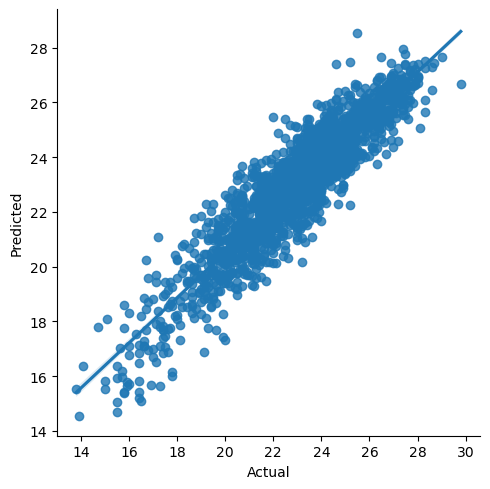

In [134]:
### Predictions
next_Tmin_df = pd.DataFrame({'Actual':y_test_min , 'Predicted':min_temp2_pred},columns=['Actual','Predicted'])
sns.lmplot(x='Actual',y='Predicted', data=next_Tmin_df)
next_Tmax_df.head(25)

In [135]:
import joblib
joblib.dump(min_temp2,'Next_Tmin_prediction.pkl')

next_tmin_model = joblib.load('Next_Tmin_prediction.pkl')
result = min_temp2.score(x_test_min,y_test_min)
print(result)


0.8423359130327969


### Now we have saved, 2 models One is for Next_Tmax i.e., Lasso model which accuracy is 81% and For Next_Tmin accuraacy is 84.23% also Lasso model whose accuracy is high even,after Tuning the parameters.So this model works better with next_TMin comapred to next_Tmax.